In [1]:
import jax
import jax.nn as jnn
import jax.numpy as jnp
import numpy as np

import equinox as eqx
import diffrax
import optax
from functools import partial

In [2]:
import os
os.chdir("..")
from policy.policy_training import DPCTrainer
from exciting_environments.pmsm.pmsm_env import PMSM, step_eps
import jax_dataclasses as jdc
from models.models import MLP_lin, MLP_tanh,MLP
#from policy.networks import MLP#,MLP2
import matplotlib.pyplot as plt

2025-01-29 10:35:15.092703: W external/xla/xla/service/gpu/nvptx_compiler.cc:760] The NVIDIA driver's CUDA version is 12.2 which is older than the ptxas CUDA version (12.6.77). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


In [3]:
gpus = jax.devices()
jax.config.update("jax_default_device", gpus[0])
jax.config.update("jax_enable_x64", True)

In [4]:
import matplotlib.pyplot as plt
from matplotlib import cm
def valid_points(Z,D,Q):
    def cond(point):
        return (point[0]**2+point[1]**2-16**2 <= 0).astype(int)
    z_flat=Z.flatten()
    points=jnp.array([D.flatten(),Q.flatten()]).T
    val_points=jax.vmap(cond,in_axes=0)(points)
    z_flat_val=z_flat*val_points
    return z_flat_val.reshape(D.shape)

def eval_psi(expert_model):
    fig = plt.figure(figsize=(12,8))
    xx = np.linspace(-16, 0, 26)
    yy = np.linspace(-16, 16, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    learned_psi={"Psi_d":expert_model.psi_d_mlp,"Psi_q":expert_model.psi_q_mlp}

    for  i,name in  zip(range(2),["Psi_d","Psi_q"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(2, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        mlp=learned_psi[name]
        z_flatt=jax.vmap(mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d) #
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(2, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(2, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_psi_and_L(expert_model):
    fig = plt.figure(figsize=(6,10))
    xx = np.linspace(-16, 0, 26)
    yy = np.linspace(-16, 16, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    learned_psi={"Psi_d":expert_model.psi_d_mlp,"Psi_q":expert_model.psi_q_mlp,
                 "L_dd":expert_model.L_dd,"L_dq":expert_model.L_dq,"L_qd":expert_model.L_qd,"L_qq":expert_model.L_qq}

    for  i,name in  zip(range(6),["Psi_d","Psi_q","L_dd","L_dq","L_qd","L_qq"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(6, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        mlp=learned_psi[name]
        z_flatt=jax.vmap(mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d)#
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(6, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(6, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_L(expert_model):
    fig = plt.figure(figsize=(12,20))
    xx = np.linspace(-16, 0, 26)
    yy = np.linspace(-16, 16, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')

    exp_values=1e-3*jax.vmap(expert_model.L_mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d)
    

    for  i,name in  zip(range(4),["L_dd","L_dq","L_qd","L_qq"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(6, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        z_flatt=exp_values[:,i]
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(6, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(6, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_det(expert_model):
    fig = plt.figure(figsize=(12,8))
    xx = np.linspace(-16, 0, 26)
    yy = np.linspace(-16, 16, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    def det_gt(i_dq):
        L_dd=motor_env.LUT_interpolators["L_dd"](i_dq)[0]
        L_dq=motor_env.LUT_interpolators["L_dq"](i_dq)[0]
        L_qd=motor_env.LUT_interpolators["L_qd"](i_dq)[0]
        L_qq=motor_env.LUT_interpolators["L_qq"](i_dq)[0]
        mat=jnp.array([[L_dd,L_dq],[L_qd,L_qq]])
        return jnp.linalg.det(mat)

    
    def det_model(i_dq):
        i_dq_norm=i_dq/motor_env.env_properties.physical_constraints.i_d
        mat=expert_model.L_matrix(i_dq_norm)
        return jnp.linalg.det(mat)

    L_det_gt=jax.vmap(det_gt)(jnp.array([D.flatten(),Q.flatten()]).T)#
    L_det_gt=L_det_gt.reshape(D.shape)
    L_det_gt=valid_points(L_det_gt,D,Q)
    L_det_pred=jax.vmap(det_model)(jnp.array([D.flatten(),Q.flatten()]).T)#
    L_det_pred=L_det_pred.reshape(D.shape)
    
    L_det_pred=valid_points(L_det_pred,D,Q)
    
    ax = fig.add_subplot(1, 3, 1, projection='3d')
    norm = plt.Normalize(L_det_gt.min(), L_det_gt.max())
    colors = cm.viridis(norm(L_det_gt))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D,Q, L_det_gt, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title("det_gt")

    ax = fig.add_subplot(1, 3, 2, projection='3d')
    norm = plt.Normalize(L_det_pred.min(), L_det_pred.max())
    colors = cm.viridis(norm(L_det_pred))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D,Q, L_det_pred, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title("det_pred")

    
    Z_difference=jnp.abs(L_det_gt - L_det_pred) #np.abs
    ax = fig.add_subplot(1, 3, 3, projection='3d')
    norm = plt.Normalize(Z_difference.min(), Z_difference.max())
    colors = cm.viridis(norm(Z_difference))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title('abs. error in mH')
    ax.ticklabel_format(style='plain')

    fig.show()
        

In [5]:
class ExpertModel(eqx.Module):
    motor_env: PMSM = eqx.field(static=True)
    psi_d_mlp: MLP
    psi_q_mlp: MLP
    
    def __init__(self,motor_env,psi_layer_sizes,L_layer_sizes,key):
        self.motor_env=motor_env
        key , subkey = jax.random.split(key)
        self.psi_d_mlp=MLP(psi_layer_sizes,key=subkey,hidden_activation=jax.nn.swish,output_activation=jax.nn.tanh)#
        key , subkey = jax.random.split(key)
        self.psi_q_mlp=MLP(psi_layer_sizes,key=subkey,hidden_activation=jax.nn.swish,output_activation=jax.nn.tanh)#,output_activation=jax.nn.tanh


    def __call__(self, init_obs, actions, tau):

        def body_fun(carry, action):
            obs = carry
            obs = self.step(obs, action, tau)
            return obs, obs

        _, observations = jax.lax.scan(body_fun, init_obs, actions)
        observations = jnp.concatenate([init_obs[None, :], observations], axis=0)
        return observations
    
    def step(self, obs ,action,tau):
        # i_d,i_q,cos_eps,sin_eps,me_omega
        obs1,_= self.motor_env.reset(self.motor_env.env_properties)  #
        obs1 = obs1.at[2].set(obs[4]*self.motor_env.env_properties.static_params.p)
        obs1 = obs1.at[0].set(obs[0])
        obs1 = obs1.at[1].set(obs[1])
        obs1 = obs1.at[4].set(obs[2])
        obs1 = obs1.at[5].set(obs[3])
        state=self.motor_env.generate_state_from_observation(obs1,self.motor_env.env_properties)
        #obs,_= self.motor_env.step(state, action, self.motor_env.env_properties)
        obs,_=self.step_expert(state,action,self.motor_env.env_properties)
        return jnp.concatenate([obs[0:2],obs[4:6],obs[2:3]])
    
    @partial(jax.jit, static_argnums=[0, 3])
    def ode_step(self, state, u_dq, properties):
        """Computes state by simulating one step.

        Args:
            system_state: The state from which to calculate state for the next step.
            u_dq: The action to apply to the environment.
            properties: Parameters and settings of the environment, that do not change over time.

        Returns:
            state: The computed state after the one step simulation.
        """
        system_state = state.physical_state
        omega_el = system_state.omega_el
        i_d = system_state.i_d
        i_q = system_state.i_q
        eps = system_state.epsilon

        args = (u_dq, properties.static_params)
        if properties.saturated:

            def vector_field(t, y, args):
                i_d, i_q = y
                u_dq, _ = args

                J_k = jnp.array([[0, -1], [1, 0]])
                i_dq = jnp.array([i_d, i_q])
                p_d = {q: interp(jnp.array([i_d, i_q])) for q, interp in self.motor_env.LUT_interpolators.items()}
                i_dq_norm=i_dq/properties.physical_constraints.i_d
                

                p_d["Psi_d"]=self.psi_d_mlp(i_dq_norm)
                p_d["Psi_q"]=self.psi_q_mlp(i_dq_norm)
                p_d["L_dd"]=self.L_dd(i_dq_norm)
                p_d["L_dq"]=self.L_dq(i_dq_norm)
                p_d["L_qd"]=self.L_qd(i_dq_norm)
                p_d["L_qq"]=self.L_qq(i_dq_norm)
            

                L_diff = jnp.column_stack([p_d[q] for q in ["L_dd", "L_dq", "L_qd", "L_qq"]]).reshape(2, 2)
                L_diff_inv=jnp.linalg.inv(L_diff)
                psi_dq = jnp.column_stack([p_d[psi] for psi in ["Psi_d", "Psi_q"]]).reshape(-1)
                di_dq_1 = jnp.einsum(
                    "ij,j->i",
                    (-L_diff_inv * properties.static_params.r_s),
                    i_dq,
                )
                di_dq_2 = jnp.einsum("ik,k->i", L_diff_inv, u_dq)
                di_dq_3 = jnp.einsum("ij,jk,k->i", -L_diff_inv, J_k, psi_dq) * omega_el
                i_dq_diff = di_dq_1 + di_dq_2 + di_dq_3
                d_y = i_dq_diff[0], i_dq_diff[1]

                return d_y

        else:

            def vector_field(t, y, args):
                i_d, i_q = y
                u_dq, params = args
                u_d = u_dq[0]
                u_q = u_dq[1]
                l_d = params.l_d
                l_q = params.l_q
                psi_p = params.psi_p
                r_s = params.r_s
                i_d_diff = (u_d + omega_el * l_q * i_q - r_s * i_d) / l_d
                i_q_diff = (u_q - omega_el * (l_d * i_d + psi_p) - r_s * i_q) / l_q
                d_y = i_d_diff, i_q_diff
                return d_y

        term = diffrax.ODETerm(vector_field)
        t0 = 0
        t1 = self.motor_env.tau
        y0 = tuple([i_d, i_q])
        env_state = self.motor_env._solver.init(term, t0, t1, y0, args)
        y, _, _, env_state, _ = self.motor_env._solver.step(term, t0, t1, y0, args, env_state, made_jump=False)

        i_d_k1 = y[0]
        i_q_k1 = y[1]

        if properties.saturated:
            torque = jnp.array([self.motor_env.currents_to_torque_saturated(i_d=i_d_k1, i_q=i_q_k1, env_properties=properties)])[
                0
            ]
        else:
            torque = jnp.array([self.motor_env.currents_to_torque(i_d_k1, i_q_k1, properties)])[0]

        with jdc.copy_and_mutate(system_state, validate=False) as system_state_next:
            system_state_next.epsilon = step_eps(eps, omega_el, self.motor_env.tau, 1.0)
            system_state_next.i_d = i_d_k1
            system_state_next.i_q = i_q_k1
            system_state_next.torque = torque  # [0]

        with jdc.copy_and_mutate(state, validate=False) as state_next:
            state_next.physical_state = system_state_next
        return state_next

    @partial(jax.jit, static_argnums=[0, 3])
    def step_expert(self, state, action, env_properties):
        """Computes state by simulating one step taking the deadtime into account.

        Args:
            system_state: The state from which to calculate state for the next step.
            action: The action to apply to the environment.
            properties: Parameters and settings of the environment, that do not change over time.

        Returns:
            state: The computed state after the one step simulation.
        """

        action = self.motor_env.constraint_denormalization(action, state, env_properties)

        action_buffer = jnp.array([state.physical_state.u_d_buffer, state.physical_state.u_q_buffer])

        if env_properties.static_params.deadtime > 0:

            updated_buffer = jnp.array([action[0], action[1]])
            u_dq = action_buffer
        else:
            updated_buffer = action_buffer

            u_dq = action

        next_state = self.ode_step(state, u_dq, env_properties)
        with jdc.copy_and_mutate(next_state, validate=True) as next_state_update:
            next_state_update.physical_state.u_d_buffer = updated_buffer[0]
            next_state_update.physical_state.u_q_buffer = updated_buffer[1]

        observation = self.motor_env.generate_observation(next_state_update, env_properties)
        return observation, next_state_update

    def psi_d(self,i_dq):
        i_dq_norm=i_dq/self.motor_env.env_properties.physical_constraints.i_d
        return self.psi_d_mlp(i_dq_norm)[0] #  self.motor_env.LUT_interpolators["Psi_d"](i_dq)[0]  
    def psi_q(self,i_dq):
        i_dq_norm=i_dq/self.motor_env.env_properties.physical_constraints.i_d
        return self.psi_q_mlp(i_dq_norm)[0]#   self.motor_env.LUT_interpolators["Psi_q"](i_dq)[0]
    def l_d_dq(self,i_dq):
        return jax.grad(self.psi_d)(i_dq)
    def l_q_dq(self,i_dq):
        return jax.grad(self.psi_q)(i_dq)
    
    def L_dd(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_d_dq(i_dq)[0]
    def L_dq(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_d_dq(i_dq)[1]
    def L_qd(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_q_dq(i_dq)[0]
    def L_qq(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_q_dq(i_dq)[1]
    
    def L_matrix(self, i_dq):
        L_dd=self.L_dd(i_dq)
        L_dq=self.L_dq(i_dq)
        L_qd=self.L_qd(i_dq)
        L_qq=self.L_qq(i_dq)
        mat=jnp.array([[L_dd,L_dq],[L_qd,L_qq]])
        return mat
    

In [6]:
motor_env = PMSM(
    saturated=True,
    LUT_motor_name="SEW",
    batch_size=1,
    control_state=[],
    static_params = {
            "p": 4,
            "r_s": 208e-3,
            "l_d": 1.44e-3,
            "l_q": 1.44e-3,
            "psi_p": 122e-3,
            "deadtime": 0,
    }
    )

## Model Learning

In [7]:
from utils.interactions import rollout_traj_env_policy
from models.model_training import ModelTrainer
from models.models import NeuralEulerODE

In [8]:
def featurize_node(obs):
    return obs#jnp.concatenate([obs[0:2],obs[4:6]])

In [9]:
#[i_d_soll, i_q_soll, i_d, i_q, u_d, u_q, T, eps_el, me_omega, u_dc, idx_out]

In [10]:
data=(jnp.load(f"model_data/data_offline_60k_27_08_24.npy"))
long_acts=data[:,4:6,:]/motor_env.env_properties.action_constraints.u_d
long_obs=data[:,[2,3,8],:]

i_d_norm=((long_obs[:,0,:]/motor_env.env_properties.physical_constraints.i_d)[:,None]) * 2 + 1
i_q_norm=(long_obs[:,1,:]/motor_env.env_properties.physical_constraints.i_q)[:,None]
me_omega_norm=(long_obs[:,2,:]/motor_env.env_properties.physical_constraints.omega_el)[:,None]
cos_long_eps=jnp.cos(jnp.array(data[:,7,:])[:,None])
sin_long_eps=jnp.sin(jnp.array(data[:,7,:])[:,None])
long_obs=jnp.concatenate([i_d_norm,i_q_norm,cos_long_eps,sin_long_eps,me_omega_norm],axis=1)

# i_d,i_q,cos_eps,sin_eps,me_omega

# long_obs_train=long_obs[:-400]
# long_acts_train=long_acts[:-400]
# long_obs_val=long_obs[-400:]
# long_acts_val=long_acts[-399:]

In [11]:
from utils.interactions import vmap_rollout_traj_node,rollout_traj_env

In [12]:
def data_gen_single(rng, sequence_len):
    rng, subkey = jax.random.split(rng)
    idx_batch = jax.random.randint(subkey, shape=(1,),minval=0, maxval=(long_obs.shape[0]))
    rng, subkey = jax.random.split(rng)
    idx_time = jax.random.randint(subkey, shape=(1,),minval=0, maxval=(long_obs.shape[2]-sequence_len-1))

    slice = jnp.linspace(
            start=idx_time, stop=idx_time + sequence_len, num=sequence_len+1, dtype=int
        ).T
    act_slice = jnp.linspace(
            start=idx_time, stop=idx_time + sequence_len-1, num=sequence_len, dtype=int
        ).T
    
    obs=long_obs[idx_batch,:,slice][0]
    acts=long_acts[idx_batch,:,act_slice][0]
    return obs,acts,rng

In [13]:
@eqx.filter_jit
def val_data_gen_single(rng, sequence_len):
    #Todo
    return None,None,rng

In [14]:
def L_det_pred(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_mat=model.L_matrix(i_dq_norm)
    return jnp.linalg.det(L_mat)

In [15]:
def L_dd(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_dd=model.L_dd(i_dq_norm)
    return L_dd

In [16]:
def L_qq(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_qq=model.L_qq(i_dq_norm)
    return L_qq

In [17]:
@eqx.filter_value_and_grad
def grad_loss(model, true_obs, actions, tau, featurize):

    feat_pred_obs = vmap_rollout_traj_node(model, featurize, true_obs[:, 0, :], actions, tau)
    # create vmap_rollout_traj_node

    feat_true_obs = jax.vmap(jax.vmap(featurize, in_axes=(0)), in_axes=(0))(true_obs)
    # eventually vmap along multiple dimensions (multiple vmaps)

    # positive determinant
    det_pred=jax.vmap(jax.vmap(L_det_pred, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    L_dds= jax.vmap(jax.vmap(L_dd, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    L_qqs= jax.vmap(jax.vmap(L_qq, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    scaling_det=1e9
    scaling_pos=1e10

    return jnp.mean((feat_pred_obs - feat_true_obs) ** 2)+scaling_det*(jnp.mean(jax.nn.relu(-det_pred)))+scaling_pos*jnp.mean(jax.nn.relu(-L_dds))+scaling_pos*jnp.mean(jax.nn.relu(-L_qqs)) #
    #return jnp.mean((feat_pred_obs - feat_true_obs) ** 2)+scaling_det*(jnp.mean(jax.nn.relu(-det_pred)))+scaling_pos*jnp.mean((0.5*jnp.sign(-L_dds)+0.5)*(jax.nn.relu(-L_dds)+10/scaling_pos))+scaling_pos*jnp.mean((0.5*jnp.sign(-L_qqs)+0.5)*(jax.nn.relu(-L_qqs)+10/scaling_pos)) #

In [18]:
optimizer_node = optax.adam(1e-4)


In [19]:
batch_size=100
mtrainer=ModelTrainer(
    train_steps=500_000,
    batch_size=batch_size,
    sequence_len=1,
    featurize=featurize_node,
    train_data_gen_sin=data_gen_single,
    val_data_gen_sin= val_data_gen_single,
    model_optimizer=optimizer_node,
    tau= 1e-4,
    loss_func=grad_loss
    )
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(batch_size,)))

In [20]:
jax_key = jax.random.PRNGKey(14) # 10,11,13 worked
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)

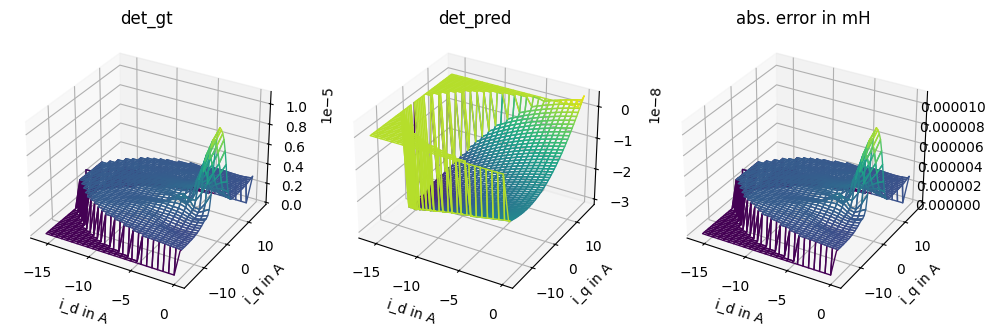

In [21]:
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

100691.72915219914


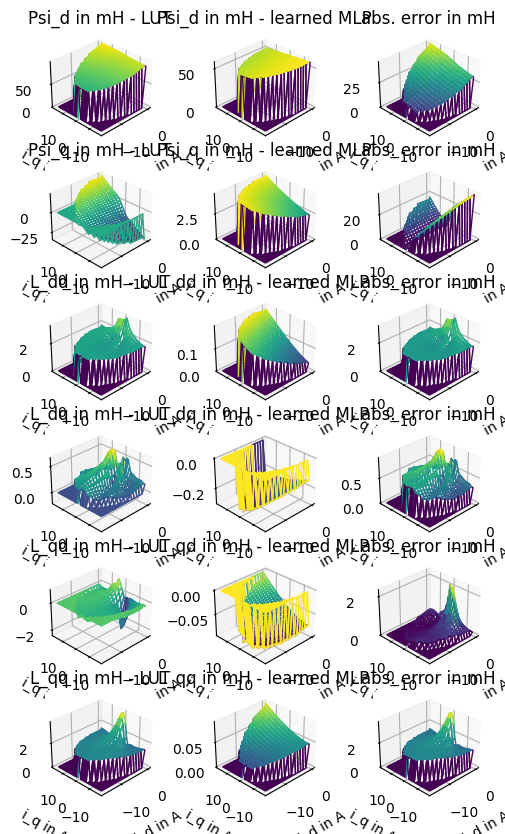

  2%|▏         | 9996/500000 [02:33<1:31:57, 88.81it/s]

0.051640011502395694


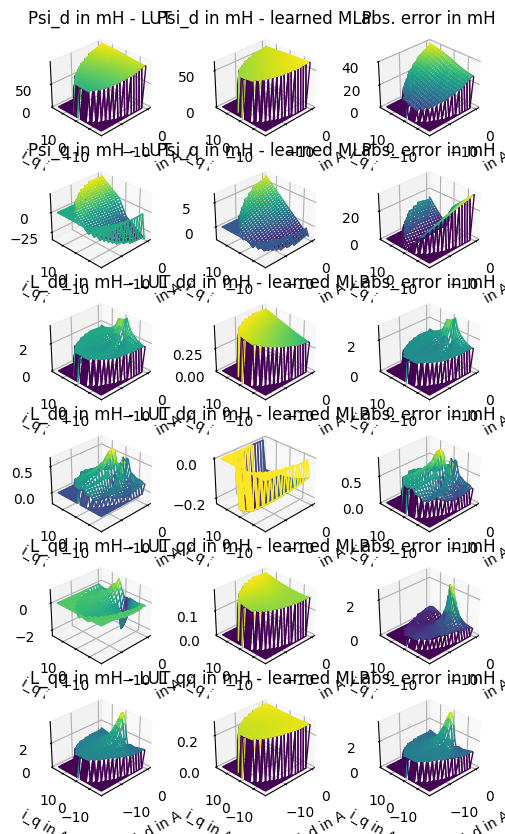

  4%|▍         | 19996/500000 [04:28<1:30:07, 88.77it/s] 

0.033424843780200504


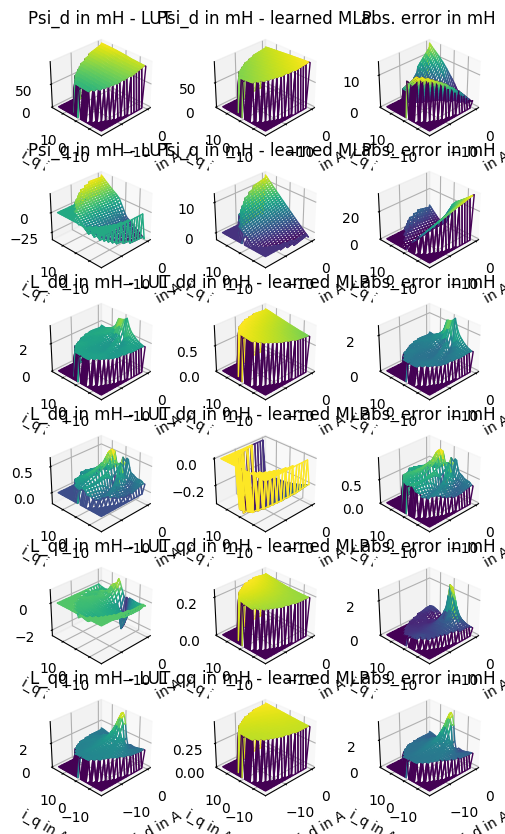

  6%|▌         | 29992/500000 [06:24<1:28:14, 88.77it/s] 

0.031577143606183564


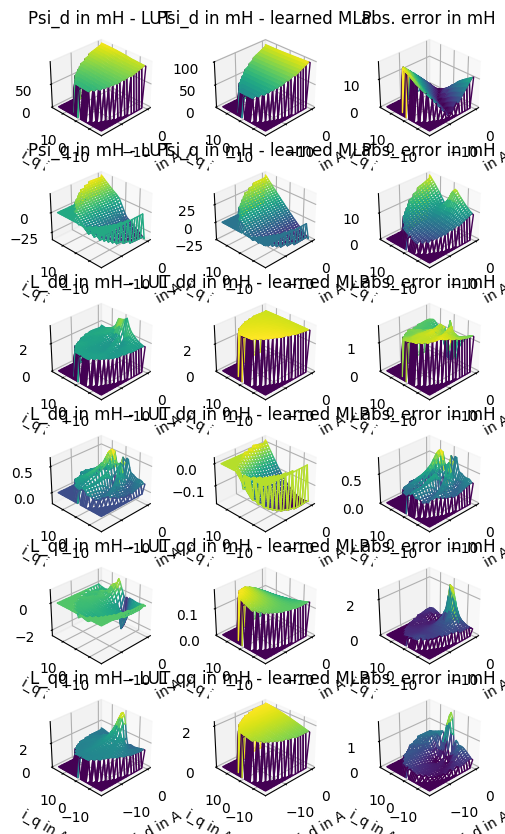

  8%|▊         | 39995/500000 [08:19<1:26:25, 88.71it/s] 

0.031636853102398825


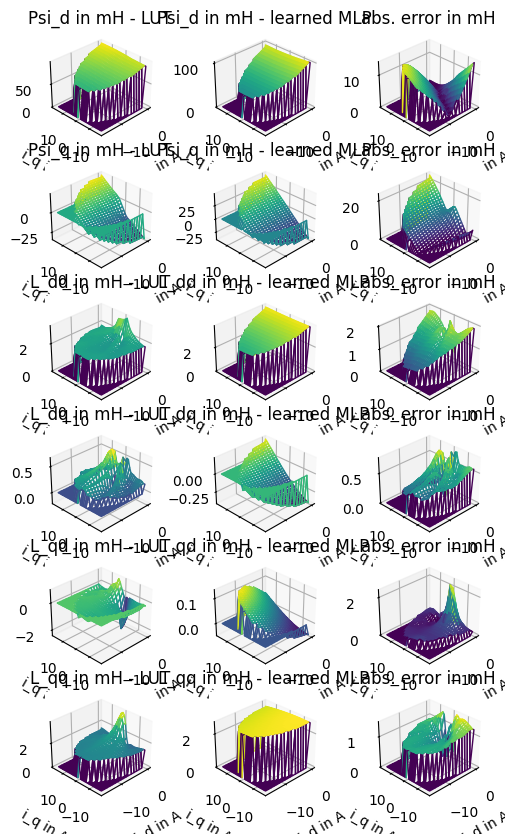

 10%|▉         | 49992/500000 [10:14<1:24:32, 88.71it/s] 

0.03159678452622766


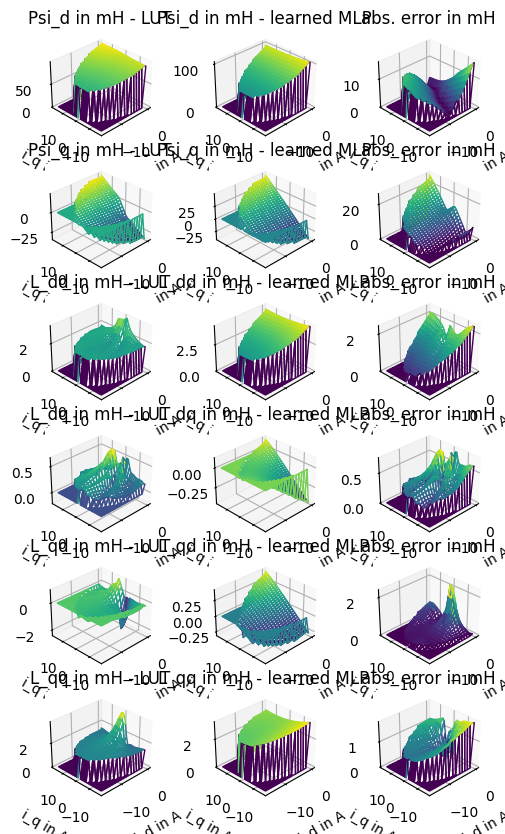

 12%|█▏        | 59999/500000 [12:09<1:22:36, 88.77it/s] 

0.031681858672082334


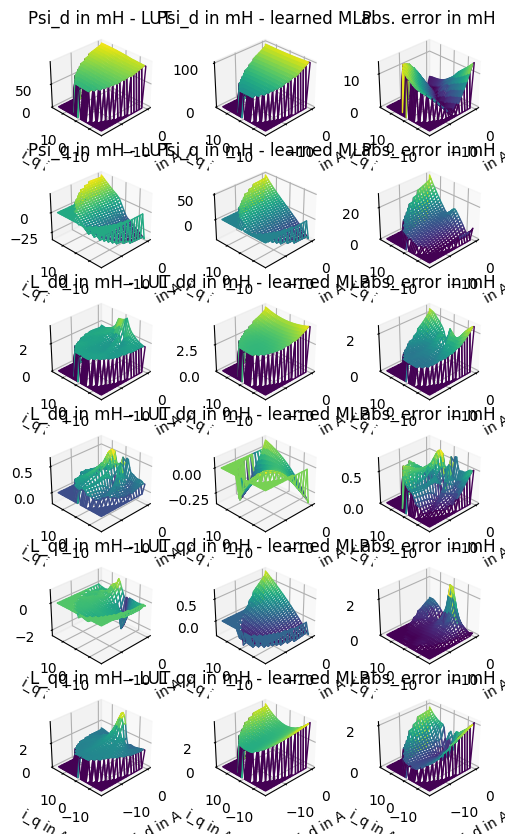

 14%|█▍        | 70000/500000 [14:05<1:20:44, 88.77it/s] 

0.03164074768323236


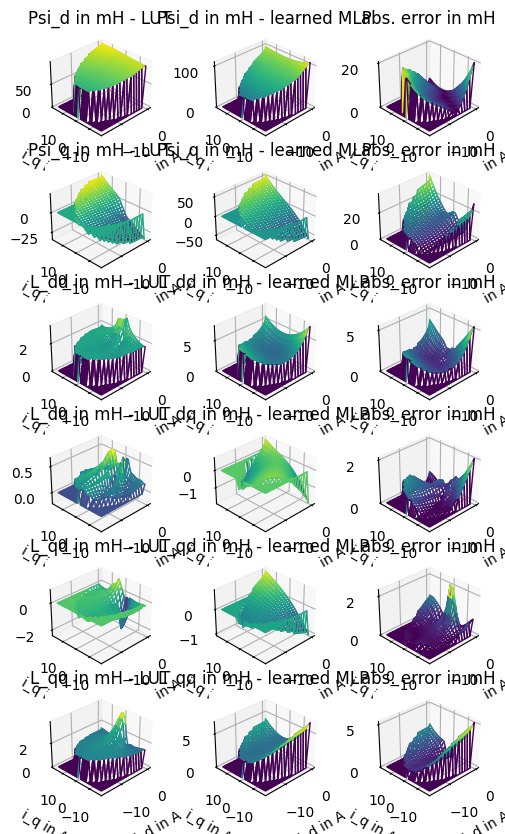

 16%|█▌        | 79996/500000 [16:00<1:18:53, 88.73it/s] 

0.031590549866767716


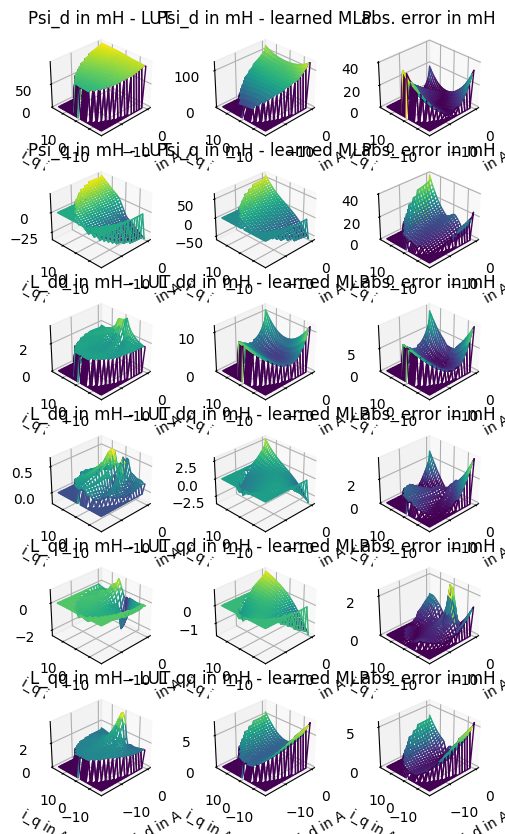

 18%|█▊        | 89993/500000 [17:55<1:17:00, 88.73it/s]

0.031579836858394376


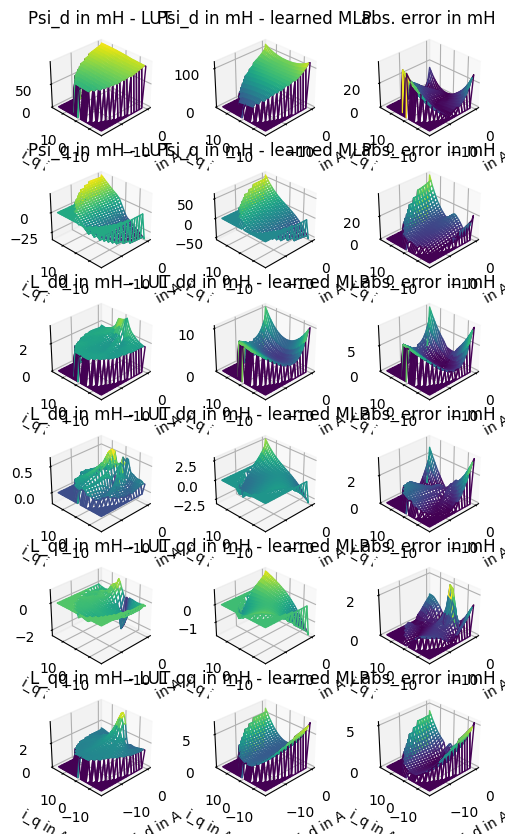

 20%|█▉        | 99999/500000 [19:51<1:15:05, 88.78it/s] 

0.031594486316400994


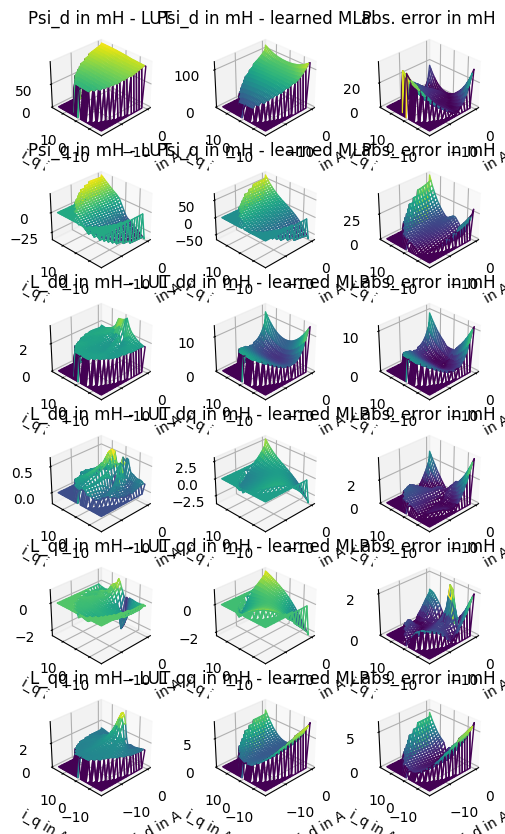

 22%|██▏       | 109996/500000 [21:46<1:13:11, 88.81it/s] 

0.03160546690873677


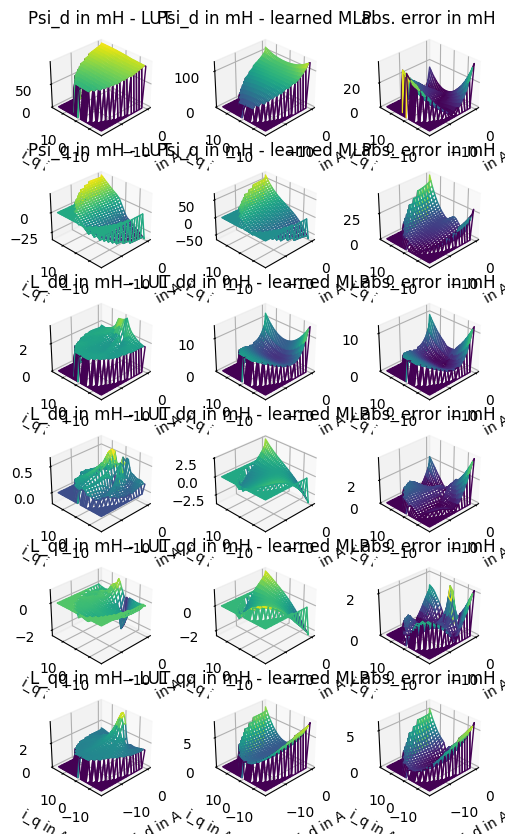

 24%|██▍       | 119993/500000 [23:42<1:11:22, 88.73it/s]

0.03153553394046864


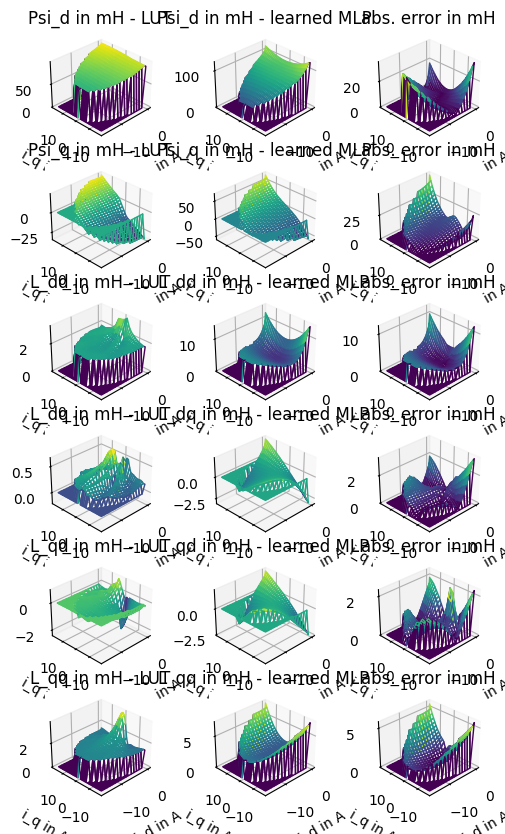

 26%|██▌       | 130000/500000 [25:37<1:09:27, 88.79it/s]

0.031579707629702615


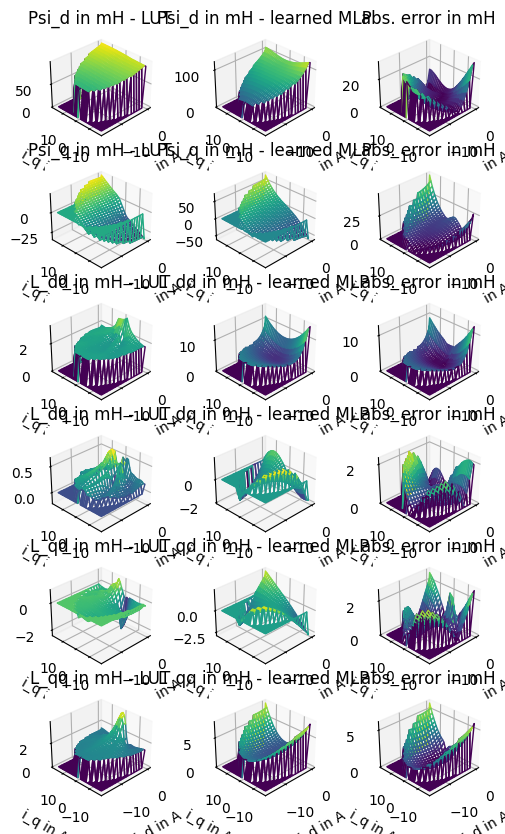

 28%|██▊       | 139997/500000 [27:33<1:07:37, 88.73it/s] 

0.031618373735022895


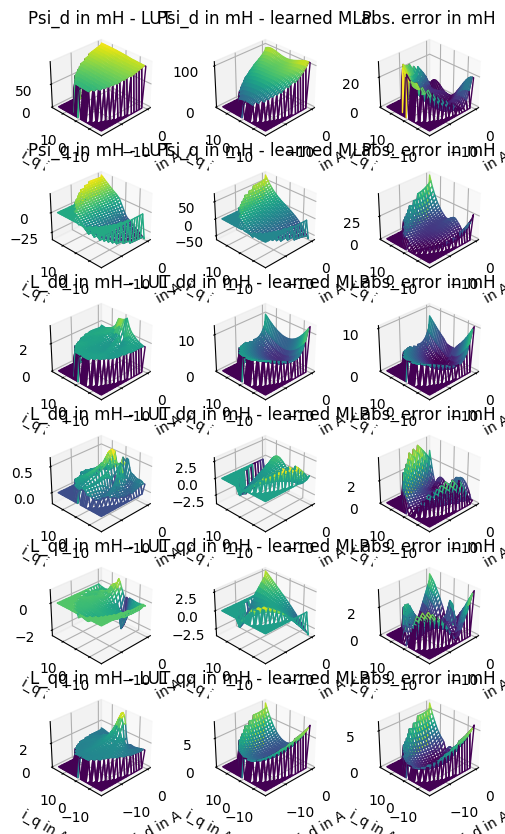

 30%|██▉       | 149995/500000 [29:28<1:05:43, 88.75it/s]

0.03159391991862597


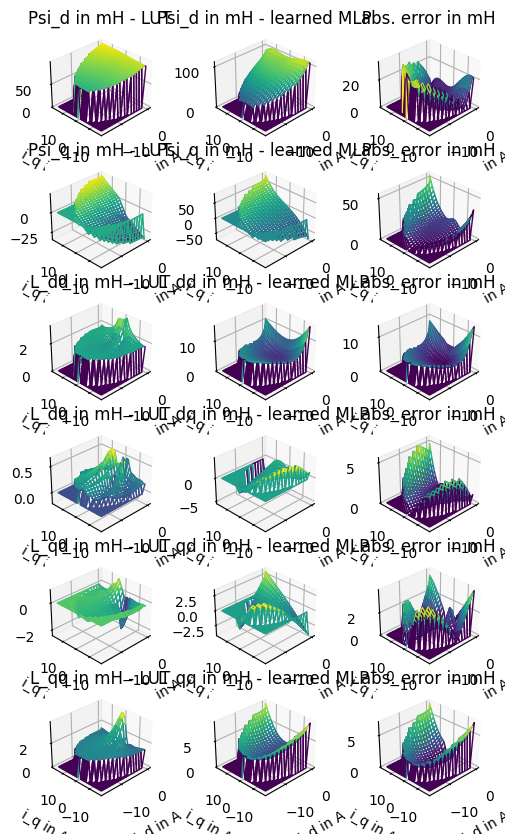

 32%|███▏      | 160000/500000 [31:23<1:03:45, 88.88it/s]

0.031525303489965864


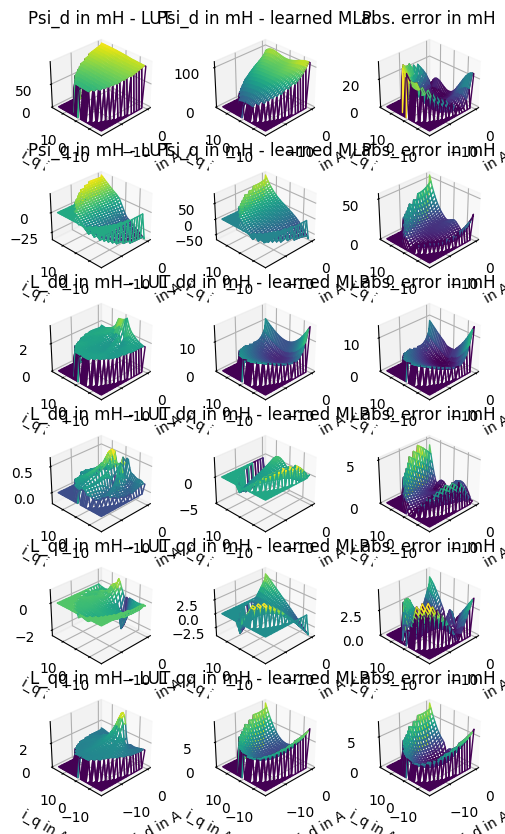

 34%|███▍      | 169999/500000 [33:19<1:01:58, 88.76it/s]

0.031593051064517645


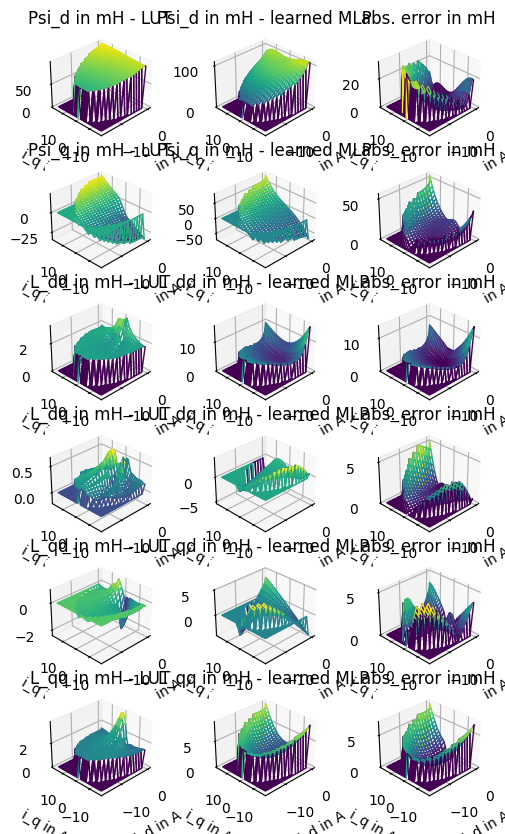

 36%|███▌      | 179997/500000 [35:15<1:00:05, 88.75it/s]

0.03155285151019248


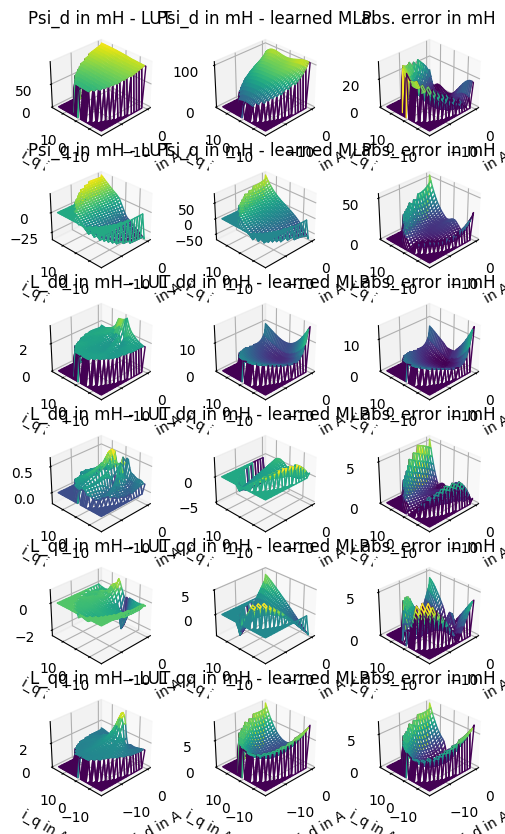

 38%|███▊      | 189994/500000 [37:10<58:10, 88.80it/s]  

0.031538939811583566


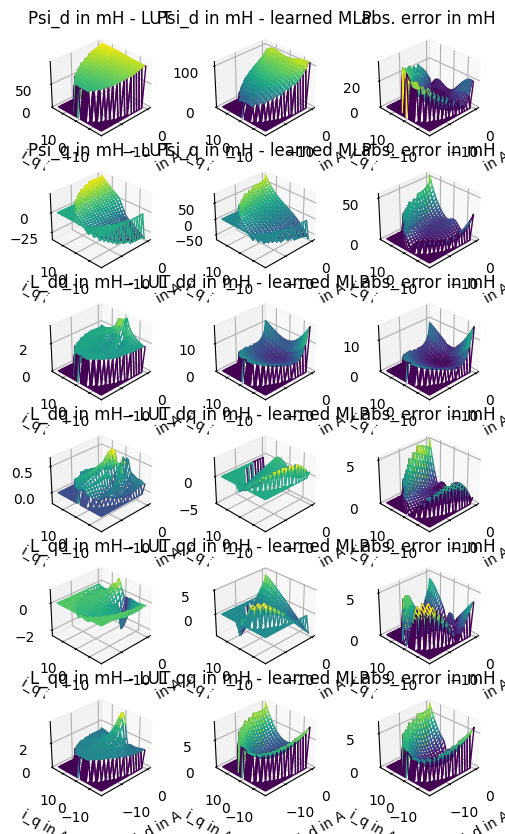

 40%|███▉      | 199993/500000 [39:05<56:23, 88.66it/s]  

0.031568484708307566


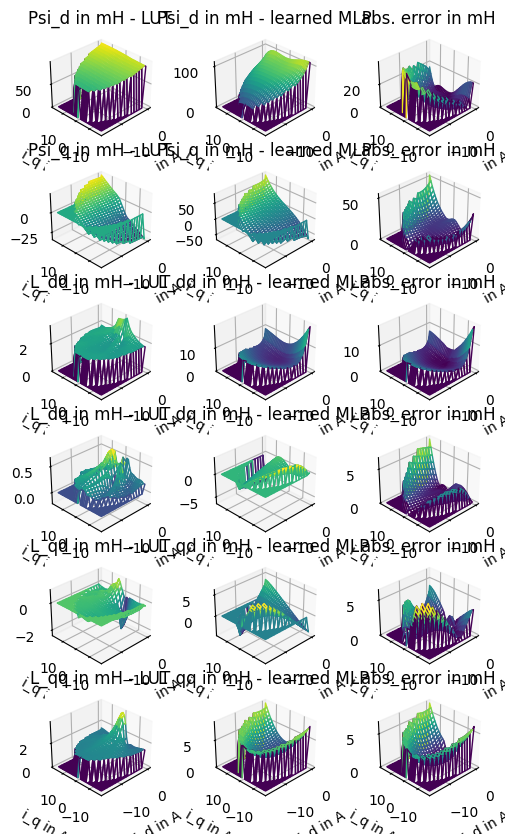

 42%|████▏     | 210000/500000 [41:01<54:26, 88.77it/s]  

0.03158435902368973


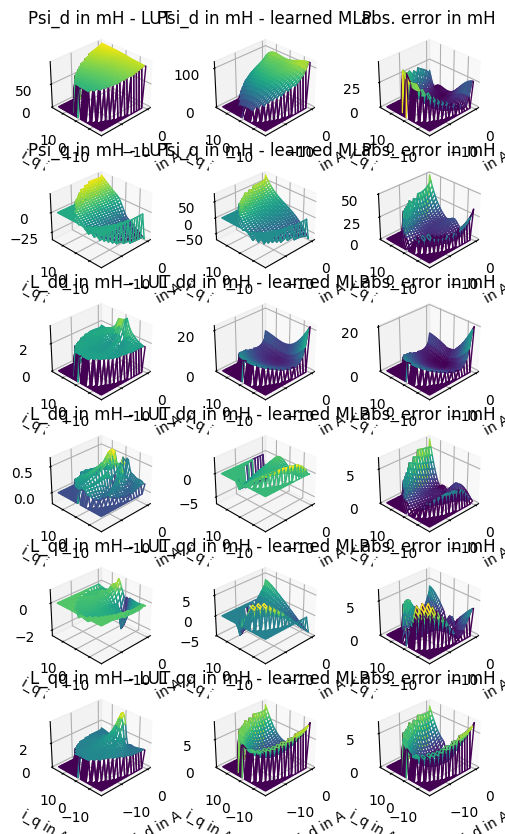

 44%|████▍     | 219999/500000 [42:57<52:35, 88.74it/s]  

0.03151573001359915


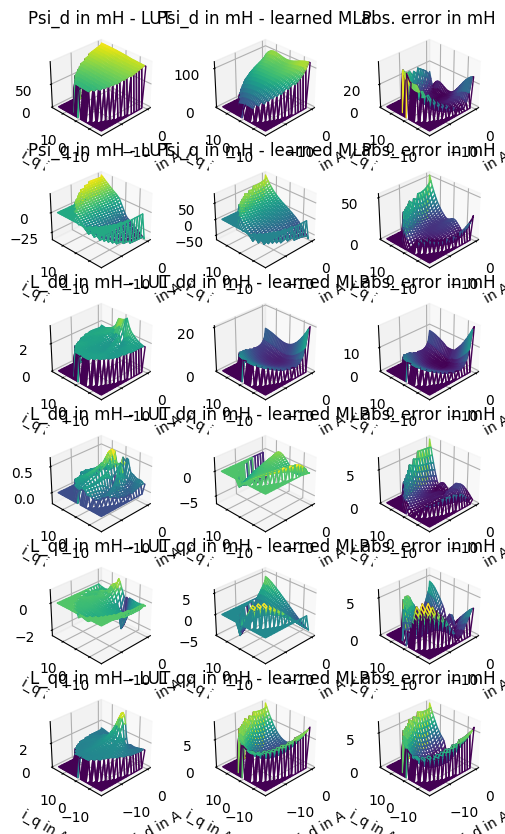

 46%|████▌     | 230000/500000 [44:53<50:44, 88.68it/s]  

0.03171875749771937


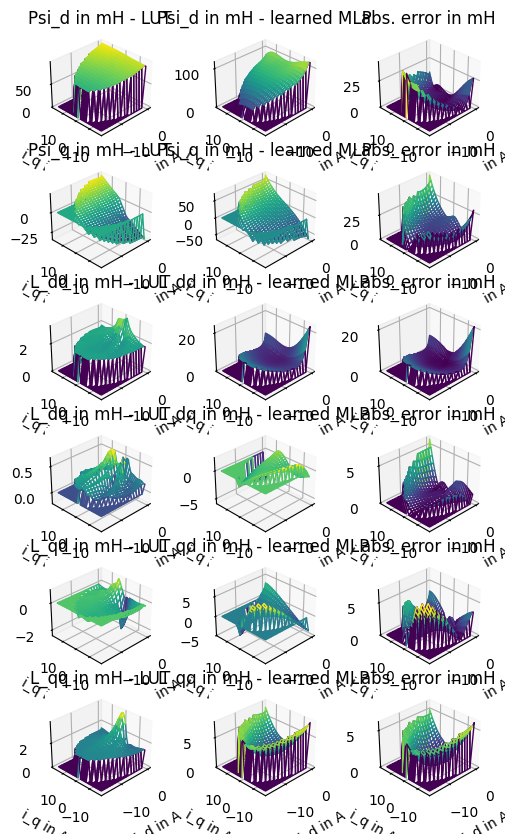

 48%|████▊     | 239999/500000 [46:48<48:50, 88.71it/s]  

0.0315740583497389


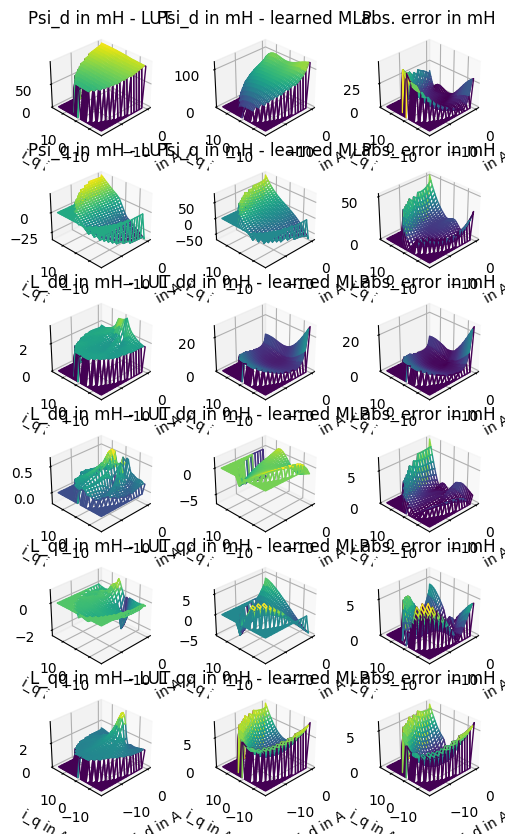

 50%|█████     | 250000/500000 [48:44<46:55, 88.78it/s]  

0.03156266591327085


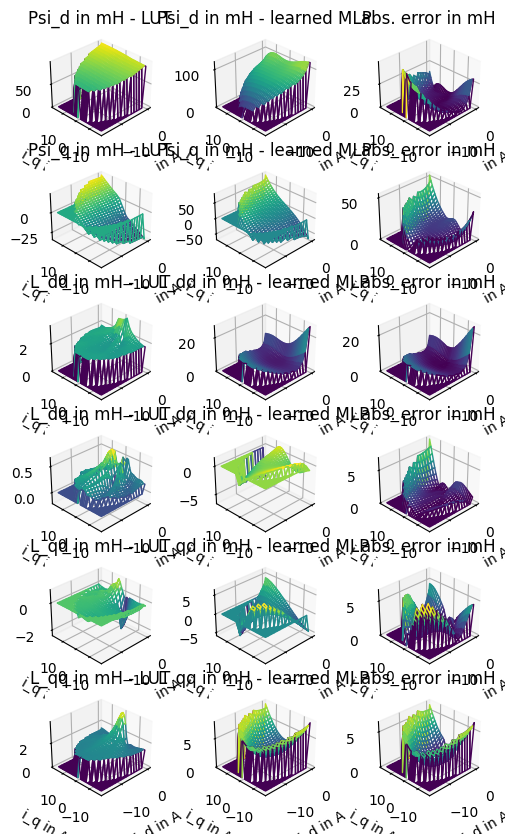

 52%|█████▏    | 259999/500000 [50:39<45:02, 88.82it/s]  

0.03165722215515653


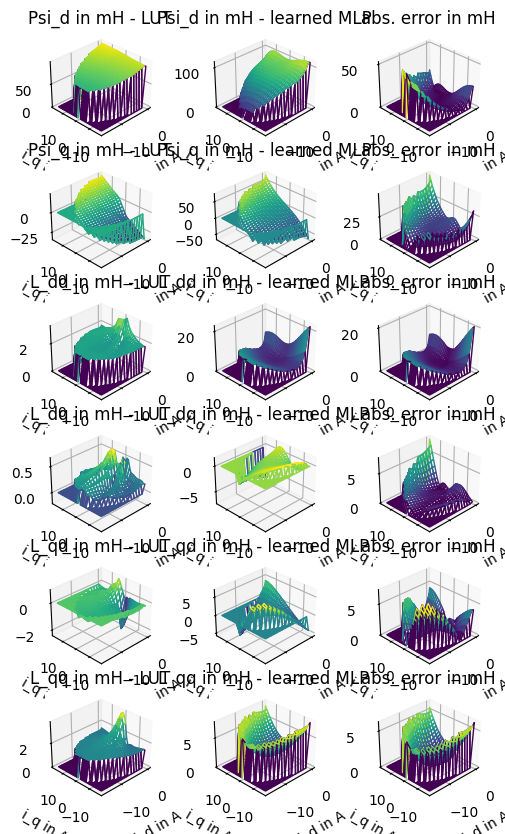

 54%|█████▍    | 269997/500000 [52:35<43:10, 88.79it/s]  

0.031617550884727876


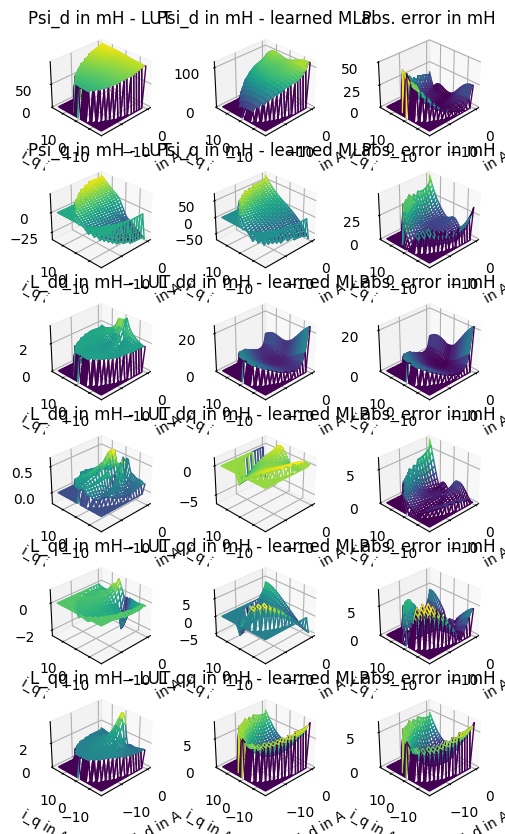

 56%|█████▌    | 279997/500000 [54:30<41:18, 88.75it/s]  

0.031588109248562


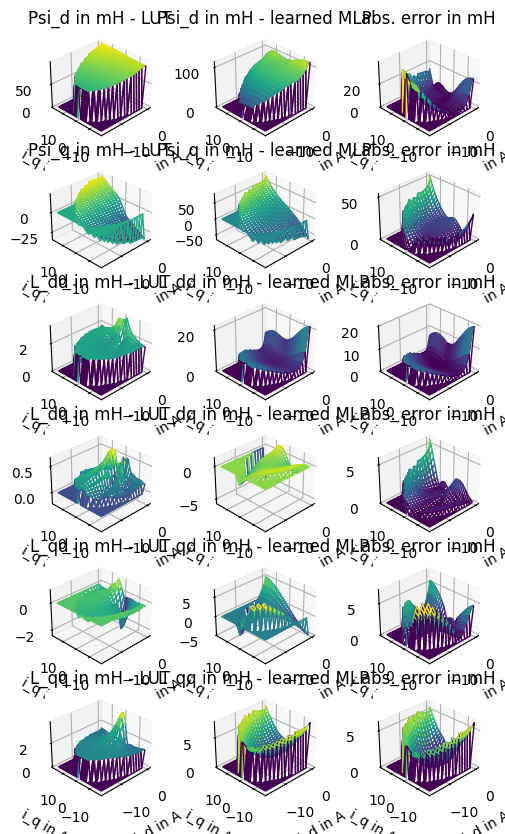

 58%|█████▊    | 289996/500000 [56:26<39:26, 88.73it/s]  

0.031573024266645364


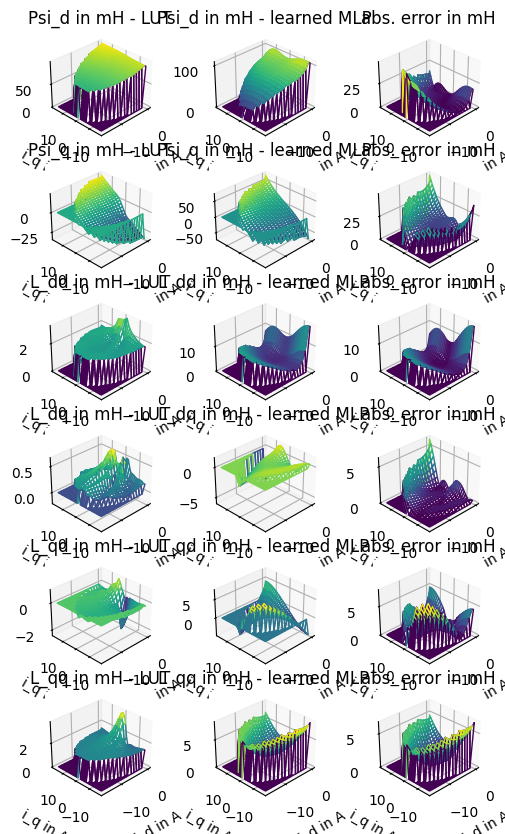

 60%|█████▉    | 299993/500000 [58:22<37:34, 88.73it/s]  

0.031503842372870246


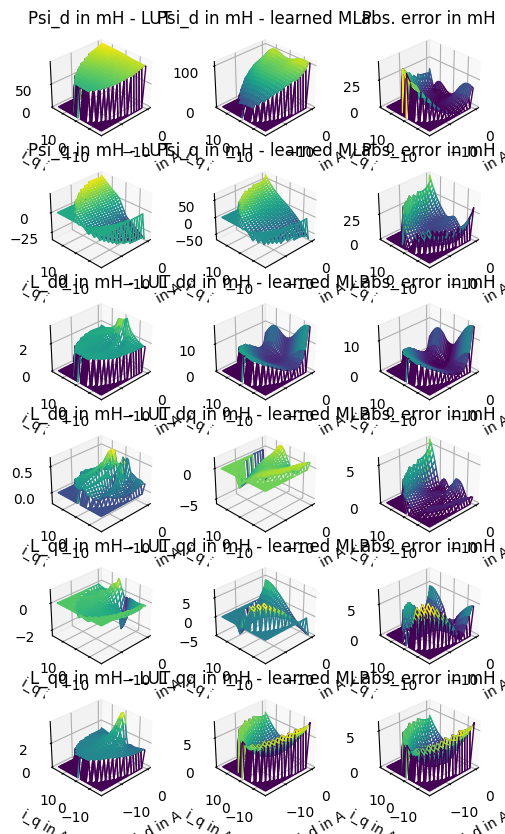

 62%|██████▏   | 309998/500000 [1:00:17<35:55, 88.13it/s]

0.031583243896095604


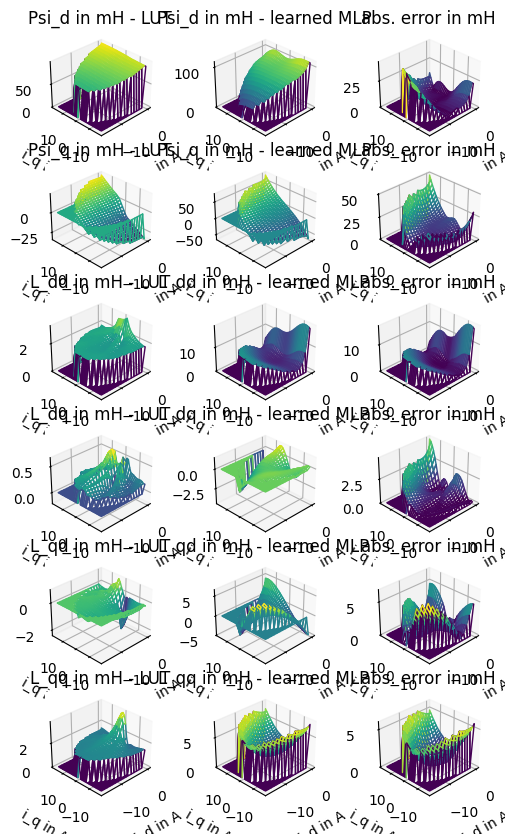

 64%|██████▍   | 319999/500000 [1:02:13<33:47, 88.77it/s]  

0.031602149714938764


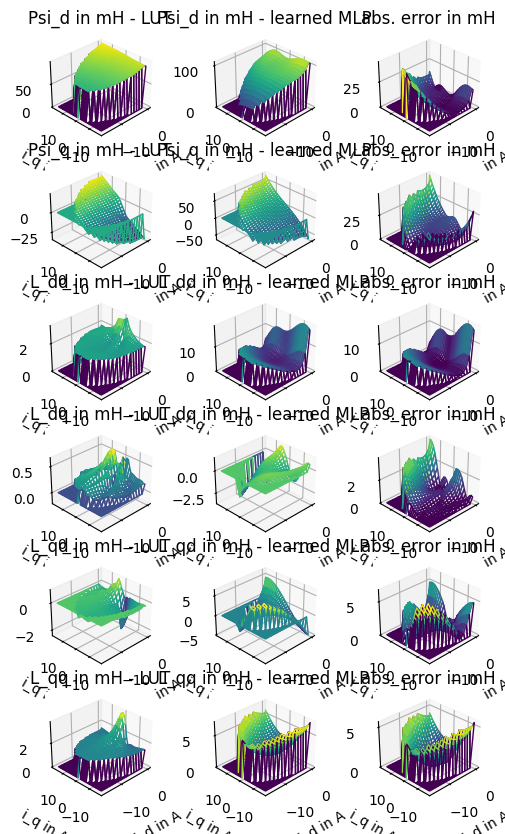

 66%|██████▌   | 329733/500000 [1:04:05<33:05, 85.74it/s]  


KeyboardInterrupt: 

In [22]:
fin_node_14,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

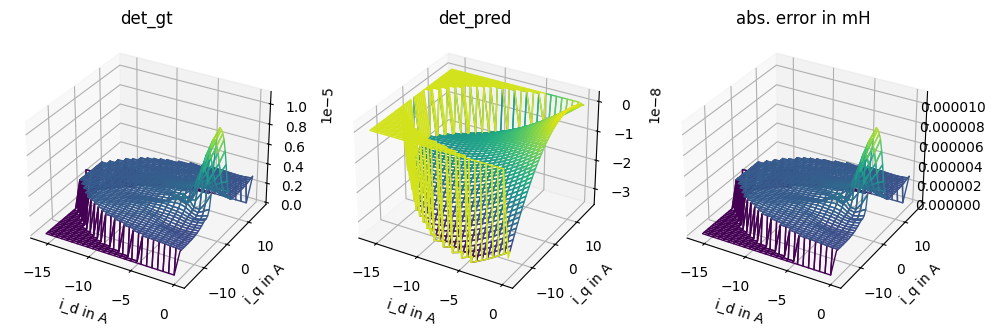

In [23]:
jax_key = jax.random.PRNGKey(20) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

4504215.261916482


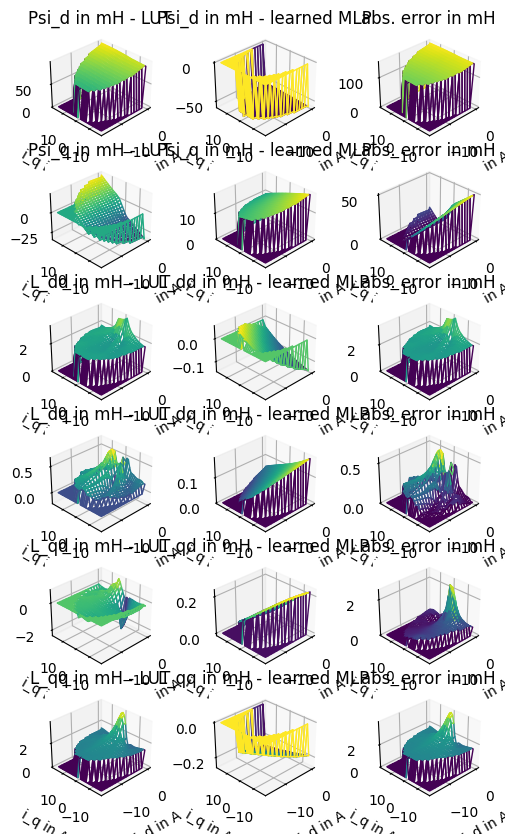

  2%|▏         | 9998/500000 [01:54<1:31:59, 88.78it/s]

35.68802099694983


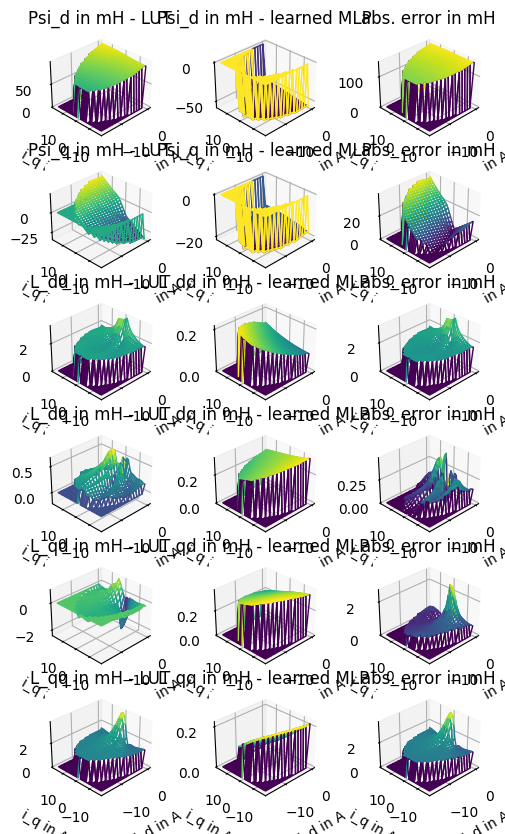

  4%|▍         | 19996/500000 [03:51<1:30:09, 88.73it/s] 

31.885494653562915


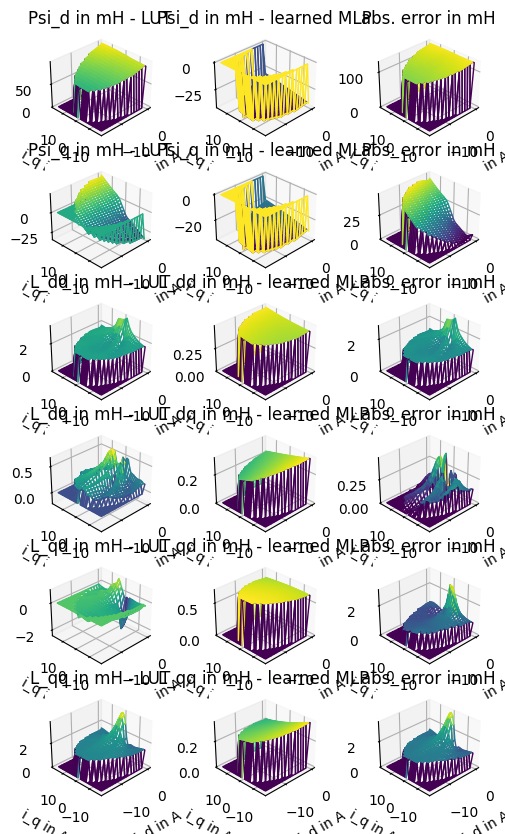

  6%|▌         | 29996/500000 [05:46<1:28:12, 88.81it/s] 

0.04929754168017868


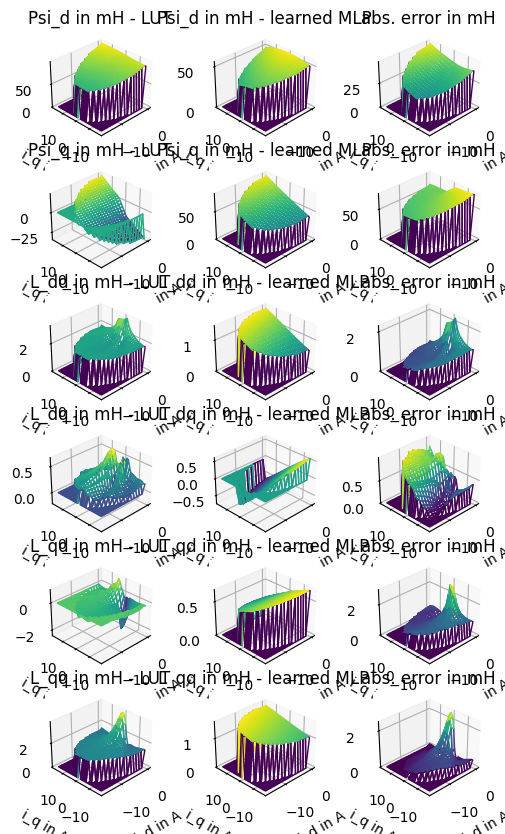

  8%|▊         | 40000/500000 [07:42<1:26:25, 88.71it/s] 

0.044550412304230985


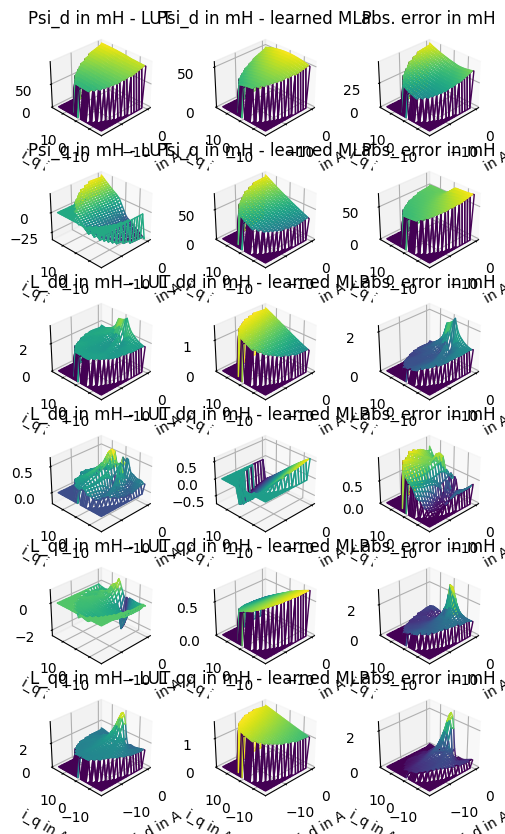

 10%|▉         | 49997/500000 [09:37<1:24:43, 88.53it/s] 

0.03192812022187804


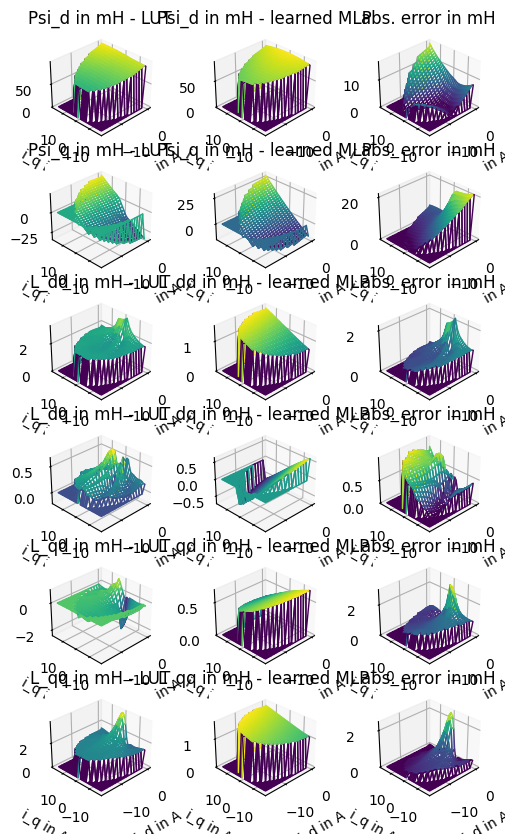

 12%|█▏        | 59995/500000 [11:33<1:22:33, 88.82it/s] 

0.03175041400597434


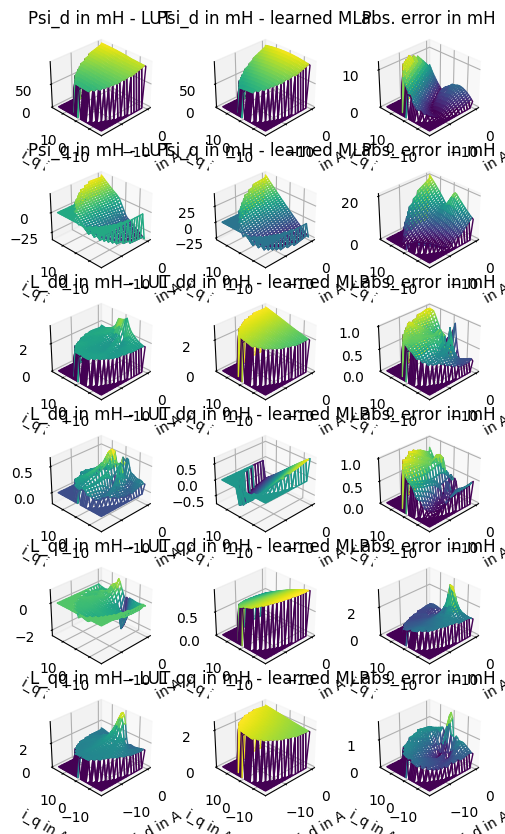

 14%|█▍        | 69994/500000 [13:28<1:20:48, 88.69it/s] 

0.03163871980296179


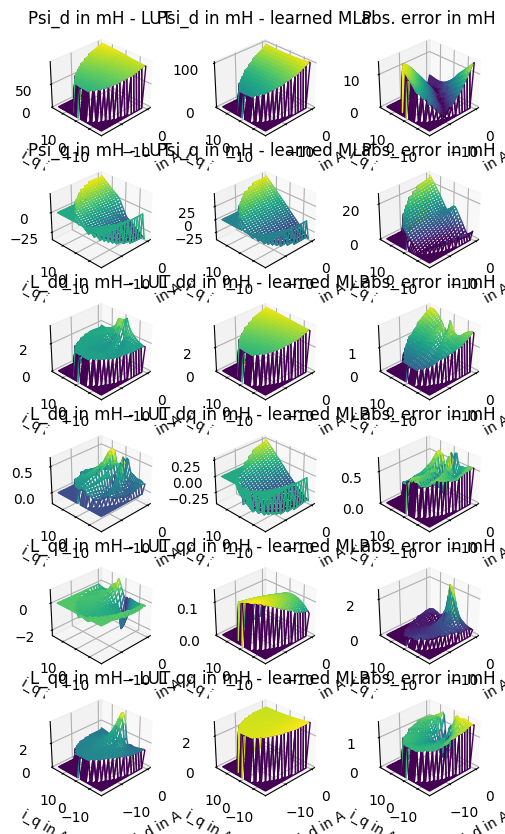

 16%|█▌        | 79995/500000 [15:24<1:18:52, 88.74it/s] 

0.03160167919469789


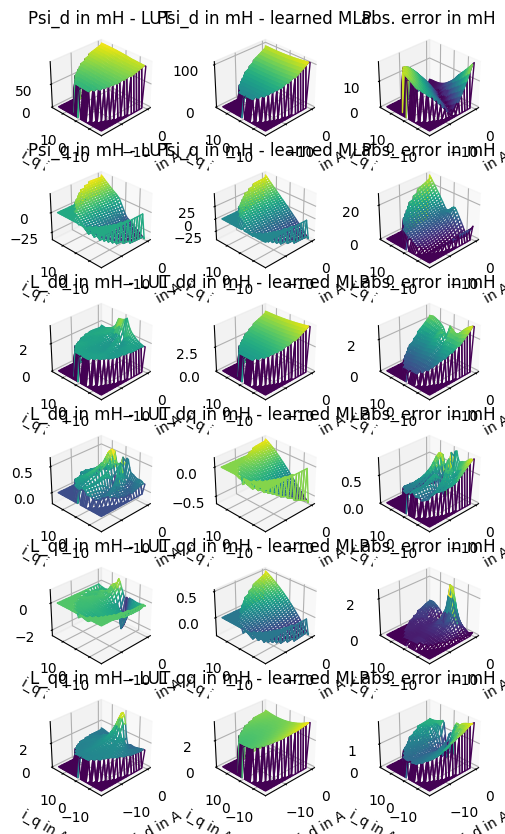

 18%|█▊        | 89995/500000 [17:20<1:16:59, 88.75it/s] 

0.031587526278299645


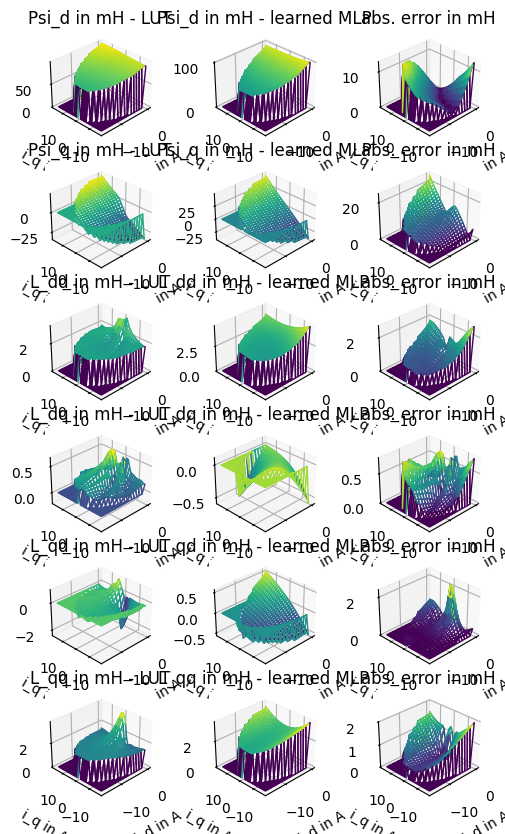

 20%|█▉        | 99992/500000 [19:15<1:15:08, 88.73it/s] 

0.031597709037283886


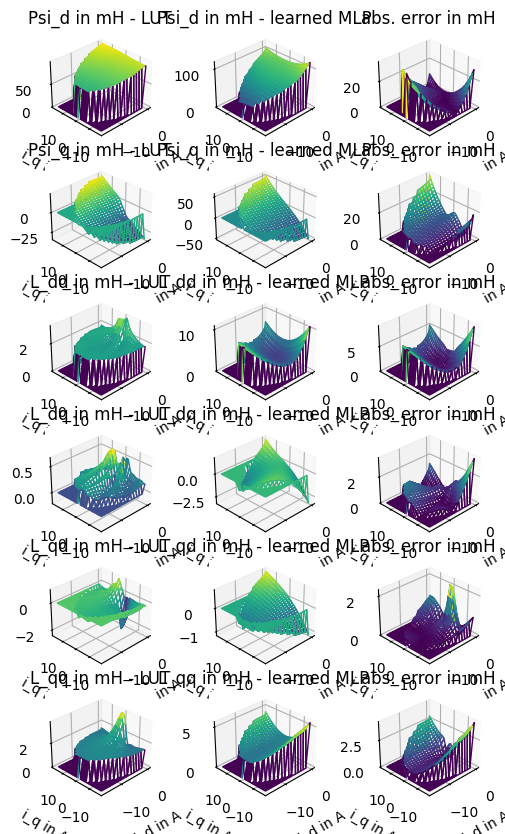

 22%|██▏       | 109997/500000 [21:11<1:13:12, 88.79it/s] 

0.031604496918217984


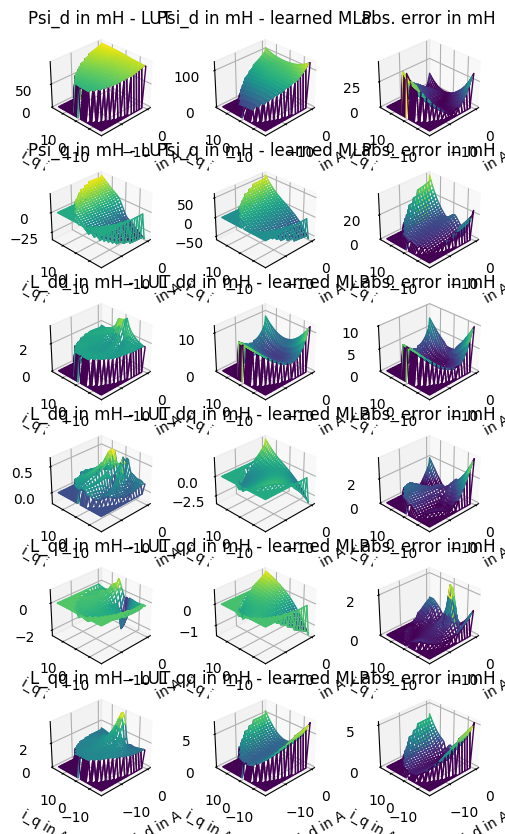

 24%|██▍       | 119995/500000 [23:06<1:11:52, 88.12it/s]

0.03153677244464929


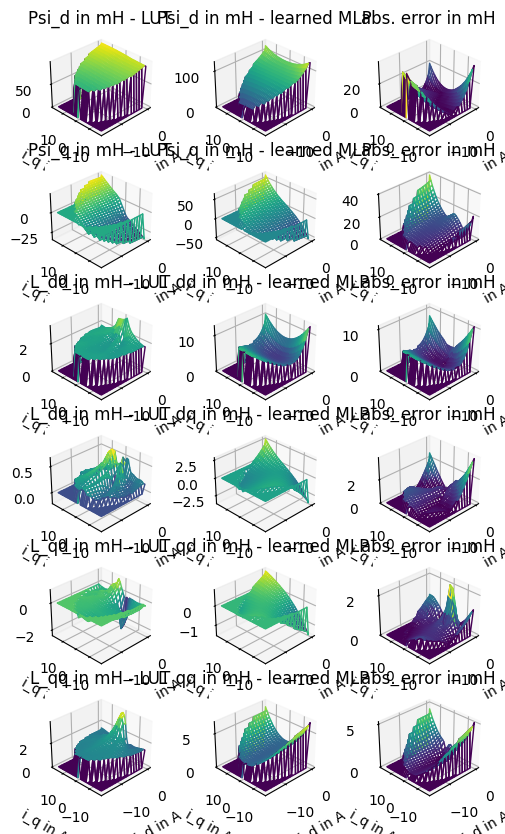

 26%|██▌       | 129993/500000 [25:03<1:09:58, 88.13it/s] 

0.03157753094391485


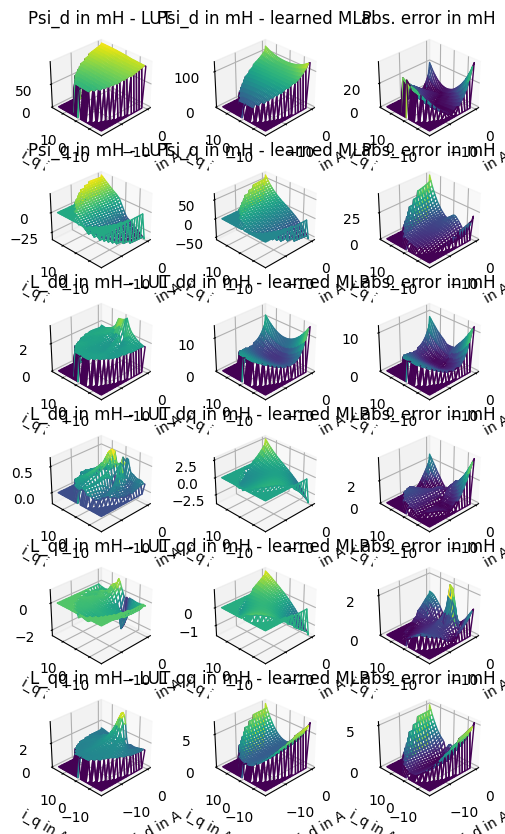

 28%|██▊       | 139998/500000 [26:58<1:07:38, 88.71it/s]

0.031615361696267316


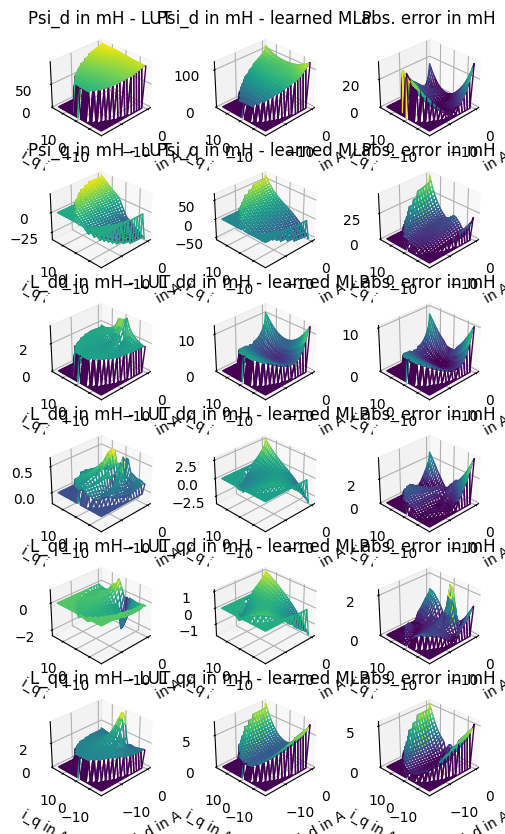

 30%|██▉       | 149997/500000 [28:53<1:05:53, 88.54it/s]

0.03160291165479191


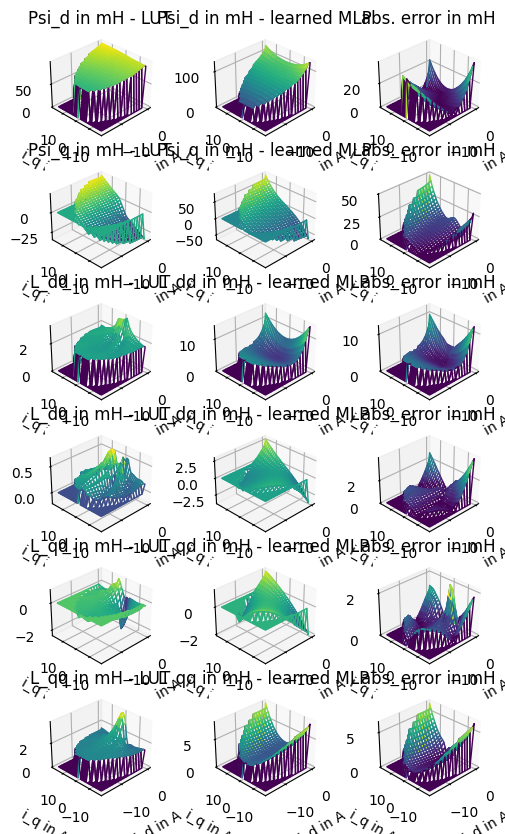

 32%|███▏      | 159994/500000 [30:50<1:04:04, 88.43it/s] 

0.03153262608092863


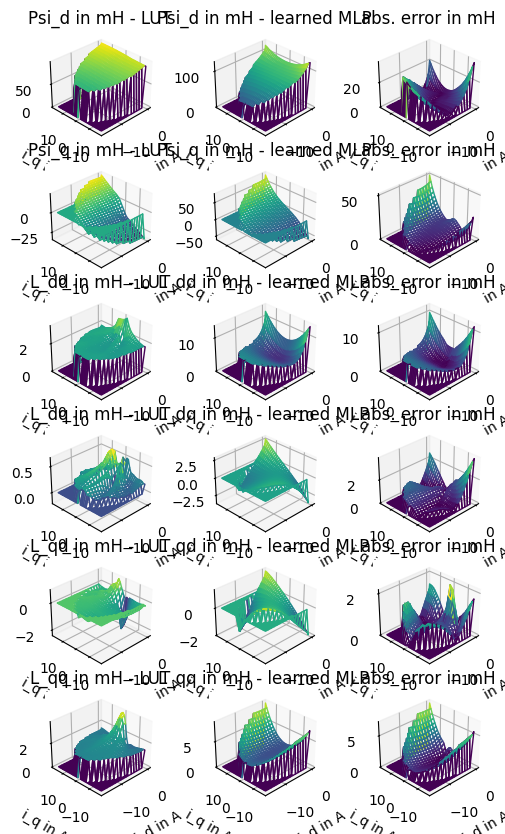

 34%|███▍      | 170000/500000 [32:45<1:02:00, 88.71it/s]

0.03158826471691778


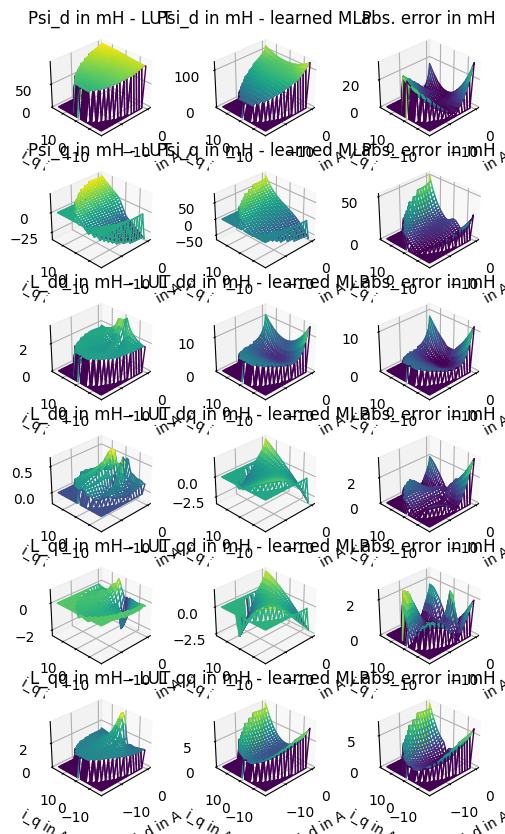

 36%|███▌      | 179997/500000 [34:41<1:00:09, 88.66it/s] 

0.03155667230335674


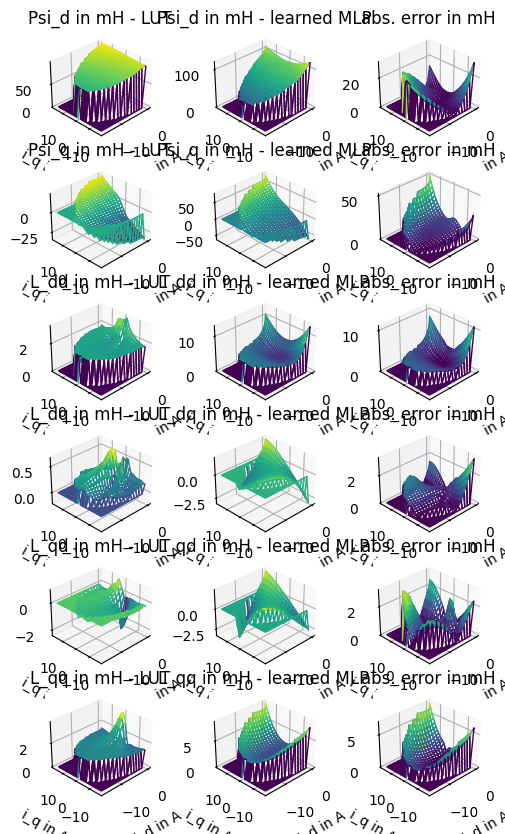

 38%|███▊      | 189996/500000 [36:37<58:12, 88.75it/s]  

0.031545532469421024


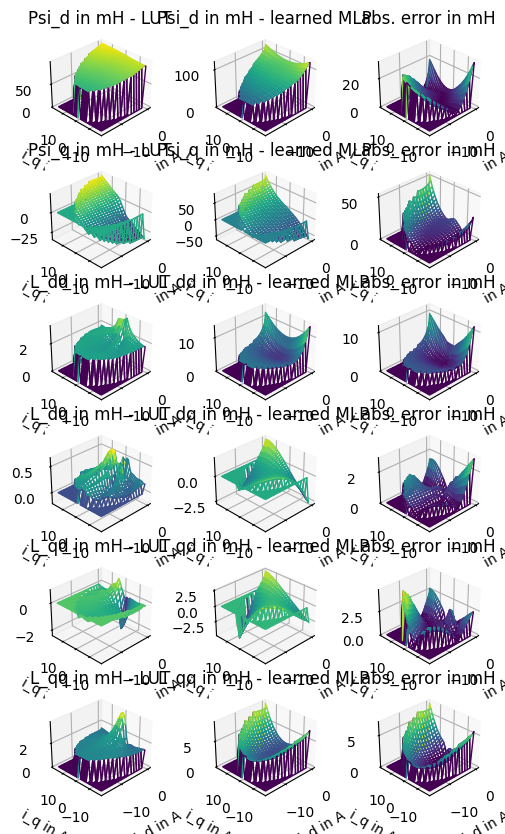

 40%|███▉      | 199998/500000 [38:32<56:22, 88.70it/s]  

0.031573760370521176


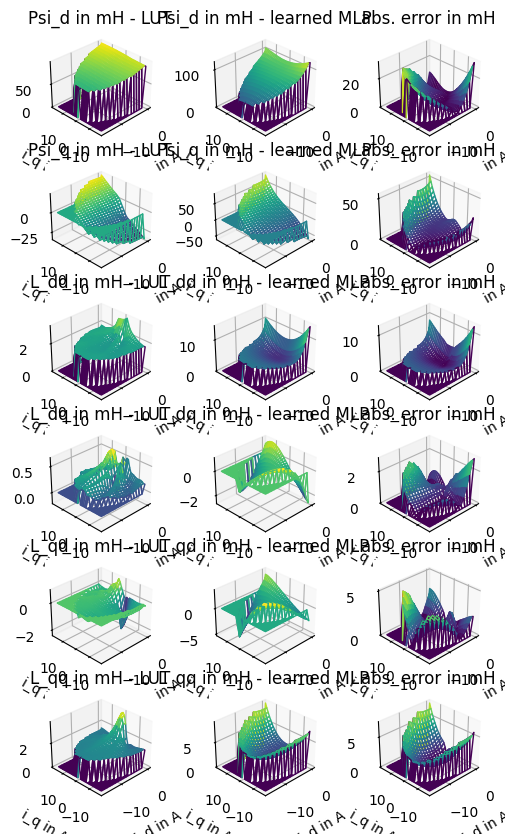

 42%|████▏     | 209995/500000 [40:29<54:26, 88.77it/s]   

0.03158449314441316


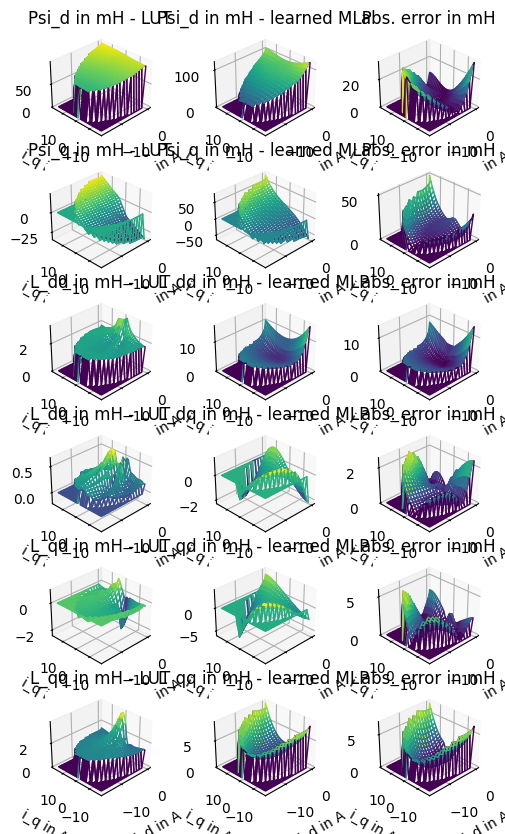

 44%|████▍     | 219992/500000 [42:24<52:37, 88.69it/s]  

0.031517535235216165


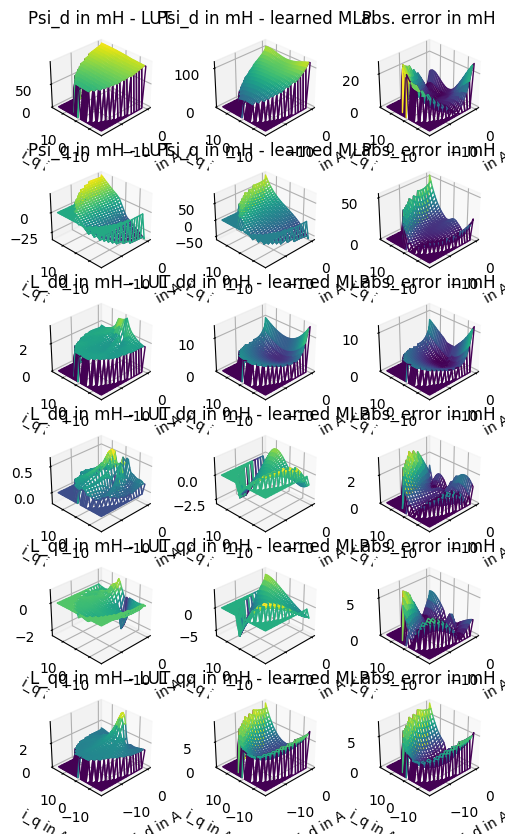

 46%|████▌     | 229997/500000 [44:21<50:44, 88.69it/s]   

0.031721854301842566


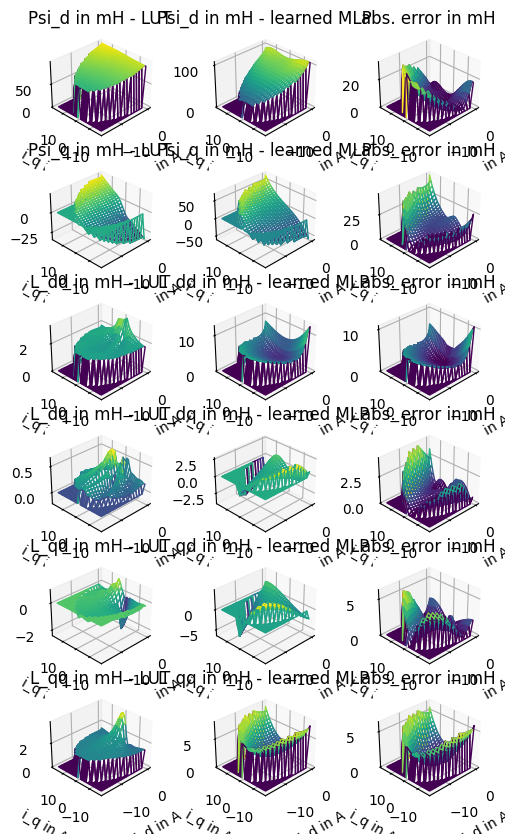

 48%|████▊     | 239997/500000 [46:16<48:51, 88.70it/s]  

0.03157779247513116


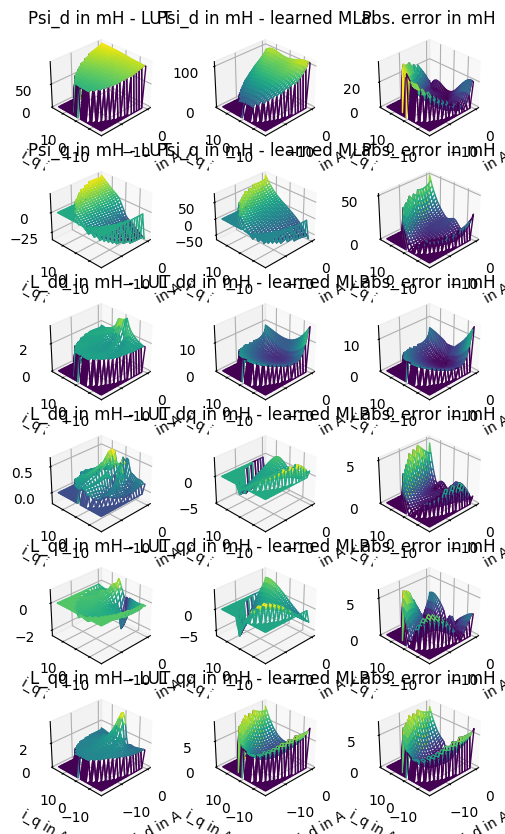

 50%|████▉     | 249995/500000 [48:12<46:57, 88.74it/s]  

0.0315561651104667


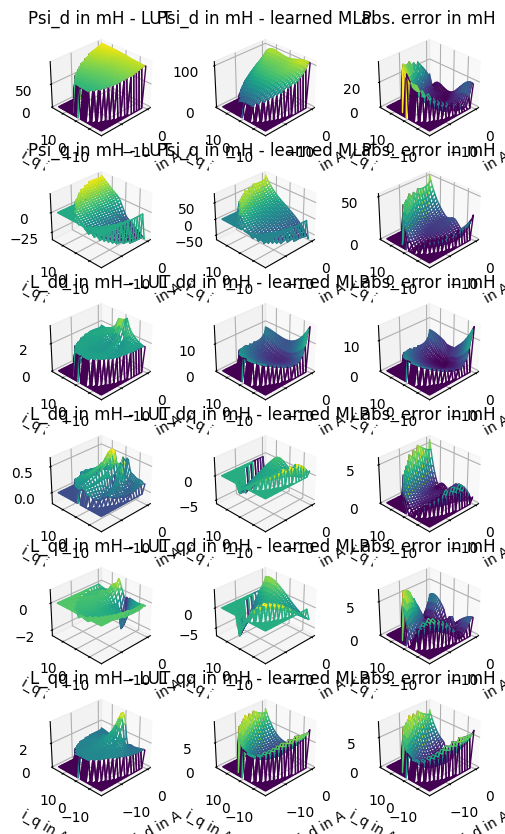

 52%|█████▏    | 260000/500000 [50:08<45:09, 88.57it/s]  

0.0316565888725248


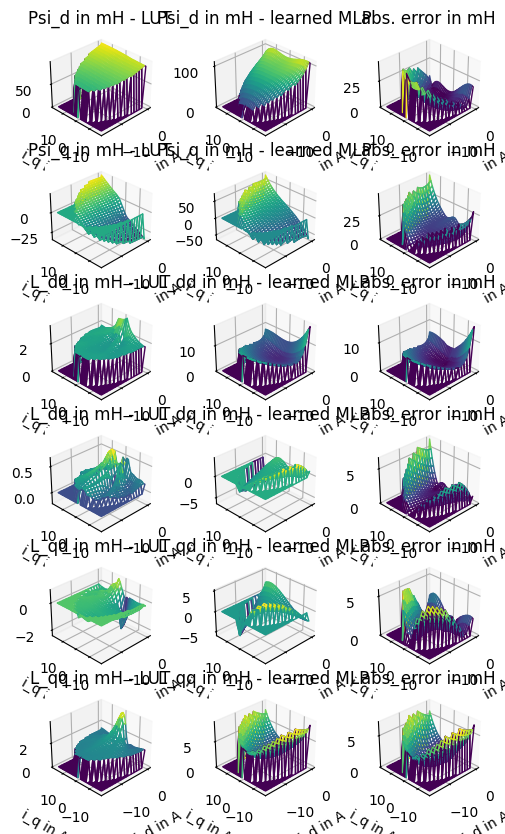

 54%|█████▍    | 269993/500000 [52:04<43:13, 88.69it/s]  

0.03162671781107541


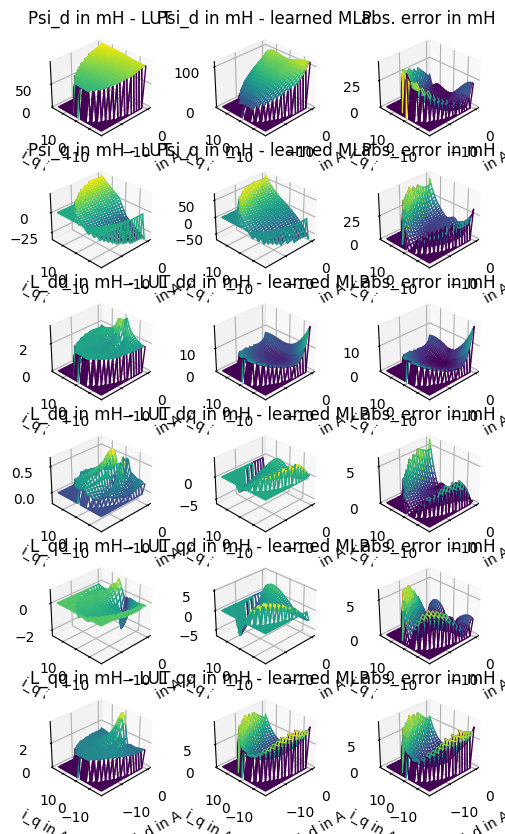

 56%|█████▌    | 279992/500000 [53:59<41:19, 88.72it/s]  

0.03159026774560255


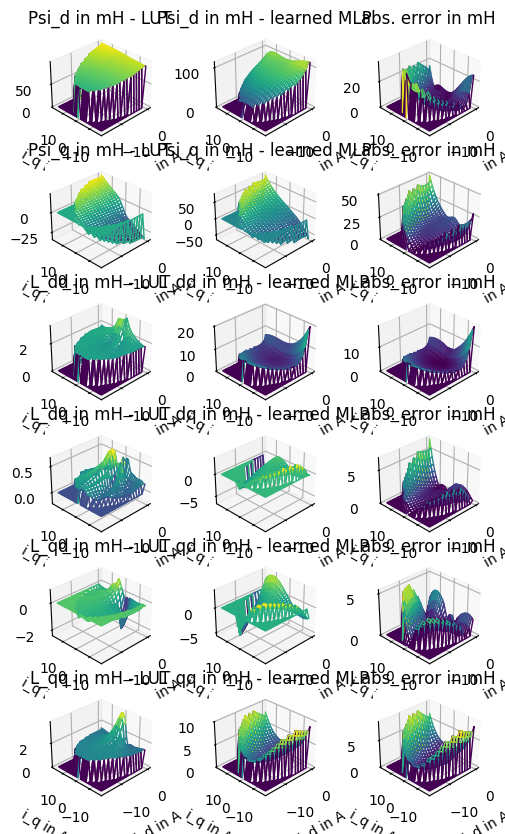

 58%|█████▊    | 290000/500000 [55:56<39:26, 88.73it/s]  

0.031573376632678396


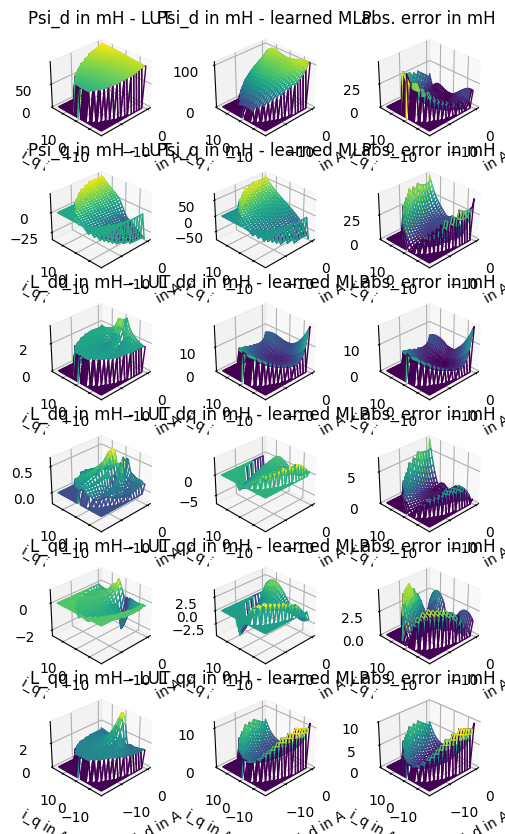

 60%|██████    | 300000/500000 [57:51<37:35, 88.68it/s]  

0.03150949846822928


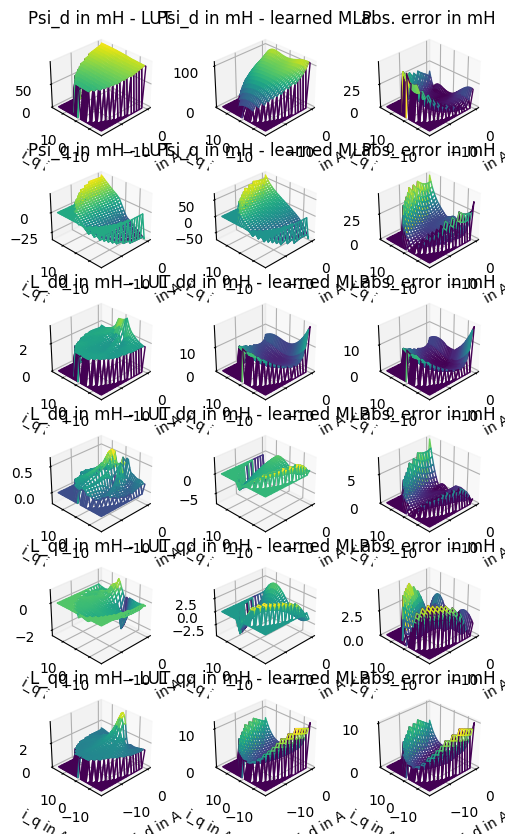

 62%|██████▏   | 309994/500000 [59:49<35:40, 88.76it/s]  

0.0315901618951905


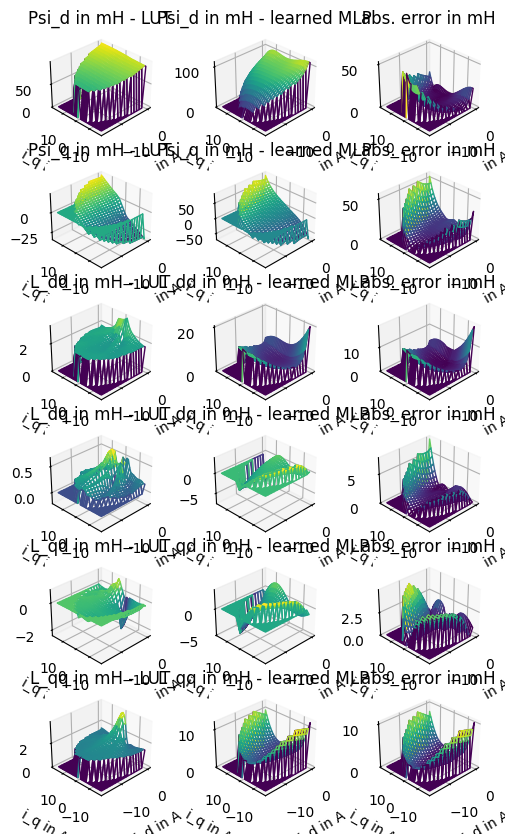

 64%|██████▍   | 319998/500000 [1:01:44<33:49, 88.70it/s]

0.03160110736514008


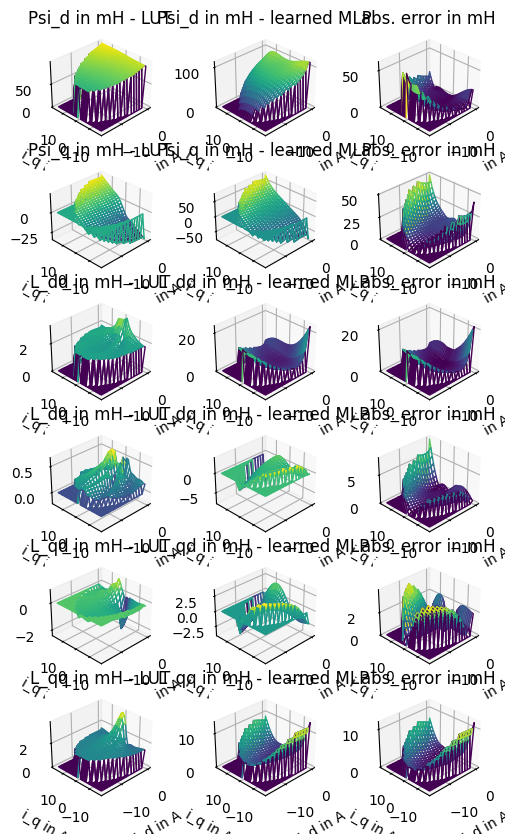

 66%|██████▌   | 329997/500000 [1:03:39<31:56, 88.72it/s]  

0.0315726196368007


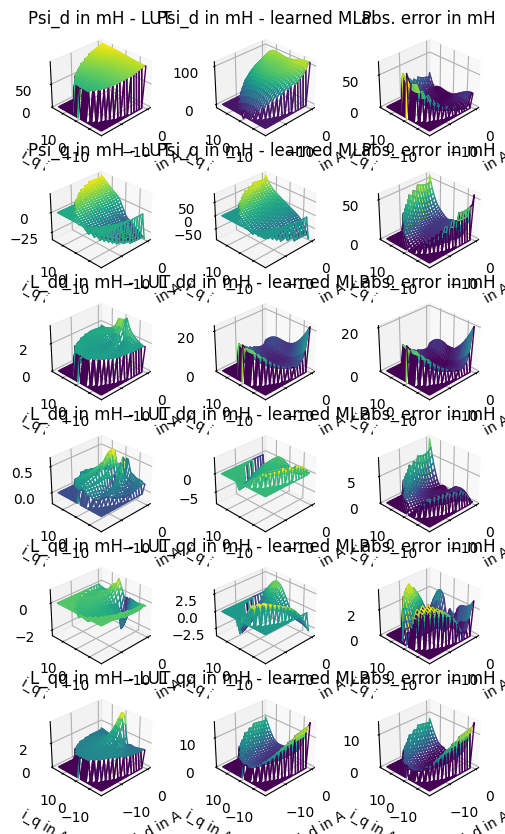

 68%|██████▊   | 339997/500000 [1:05:36<30:03, 88.69it/s]  

0.031515458896205134


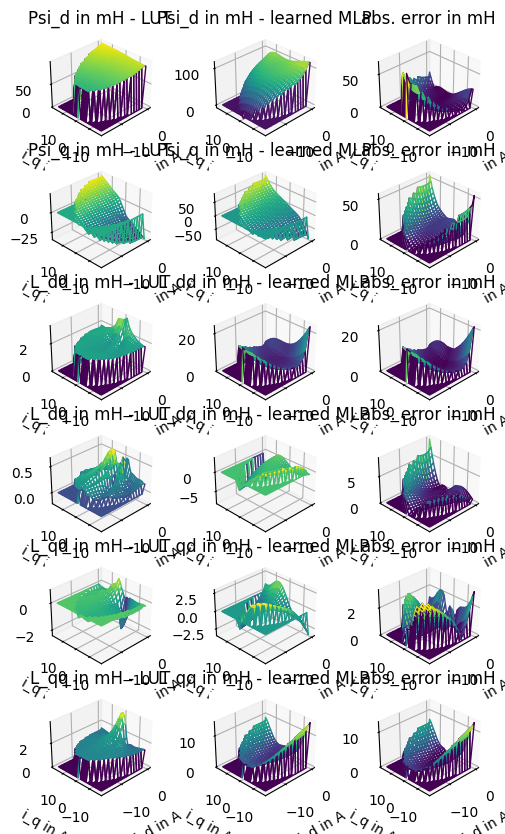

 70%|██████▉   | 349995/500000 [1:07:32<28:12, 88.64it/s]  

0.03153941675235796


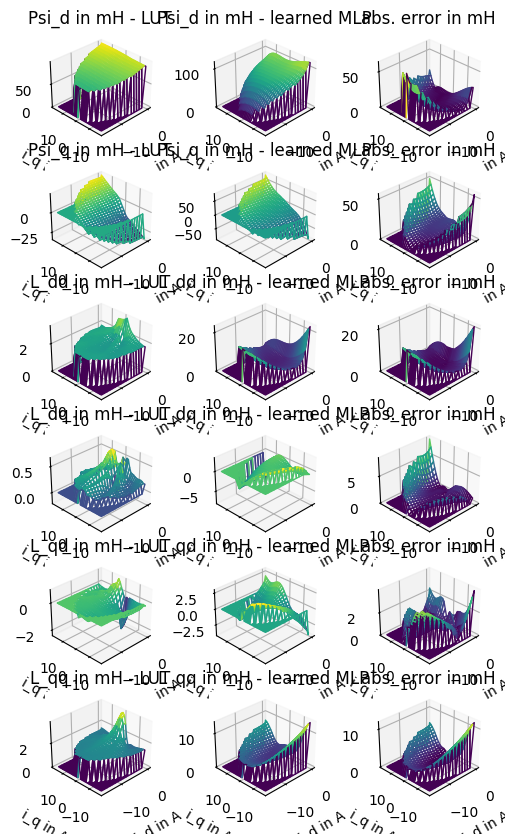

 72%|███████▏  | 359993/500000 [1:09:27<26:26, 88.23it/s]  

0.03154311204732945


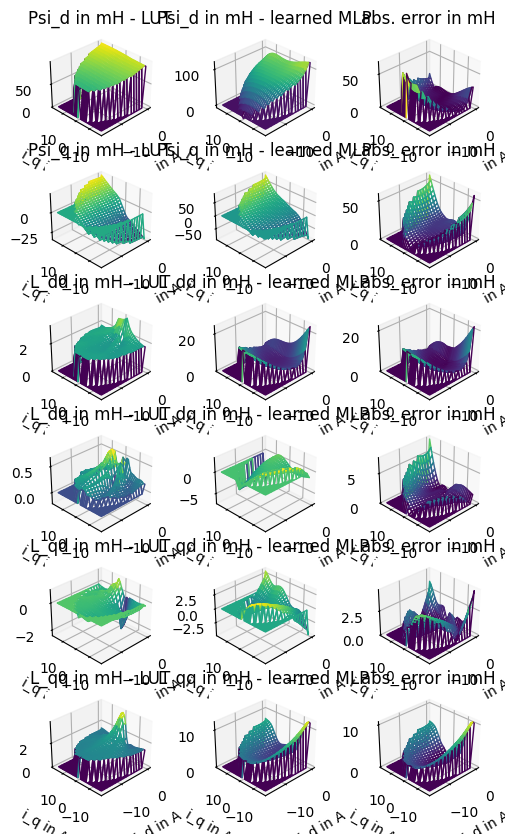

 74%|███████▍  | 369992/500000 [1:11:24<24:26, 88.63it/s]  

0.03160271507646162


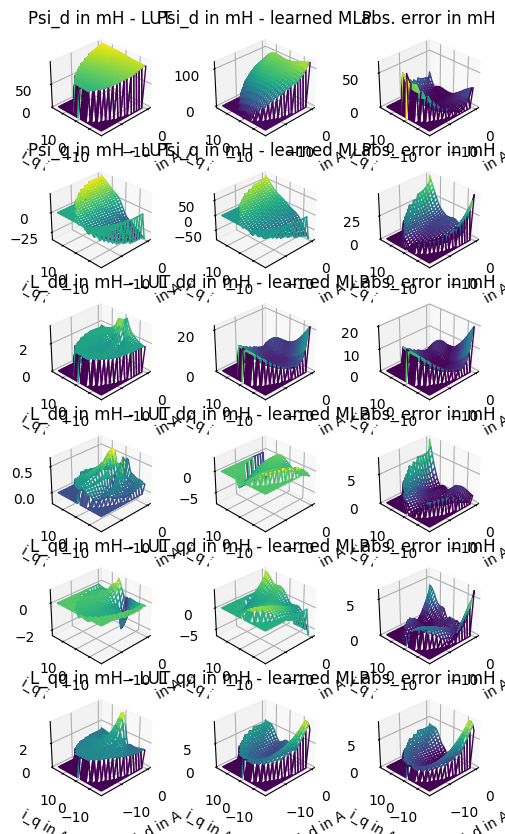

 76%|███████▌  | 379998/500000 [1:13:19<22:31, 88.77it/s]  

0.031644209136910316


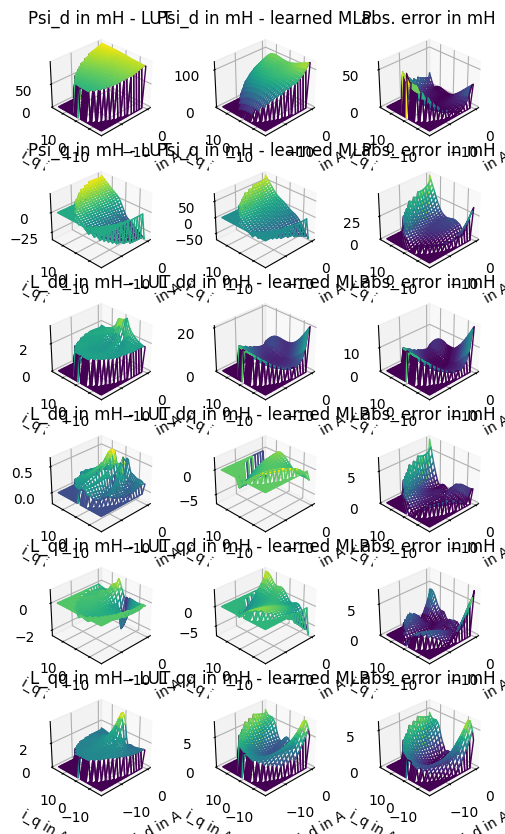

 78%|███████▊  | 389995/500000 [1:15:14<20:39, 88.73it/s]  

0.03163804103938359


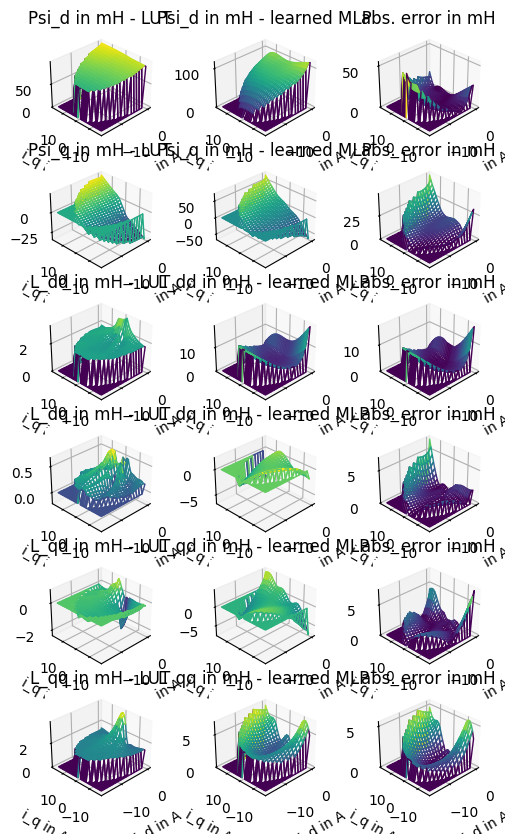

 80%|███████▉  | 399995/500000 [1:17:11<18:46, 88.74it/s]  

0.03152086549769645


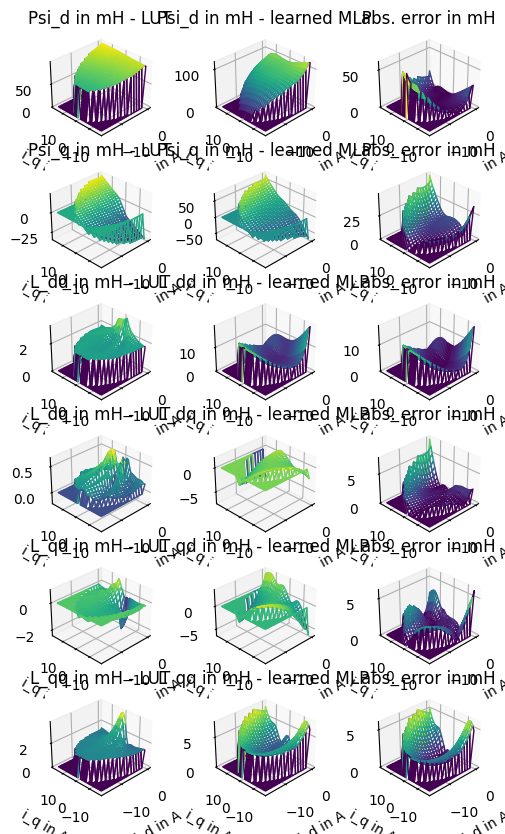

 82%|████████▏ | 409995/500000 [1:19:07<16:54, 88.75it/s]  

0.03149910432142667


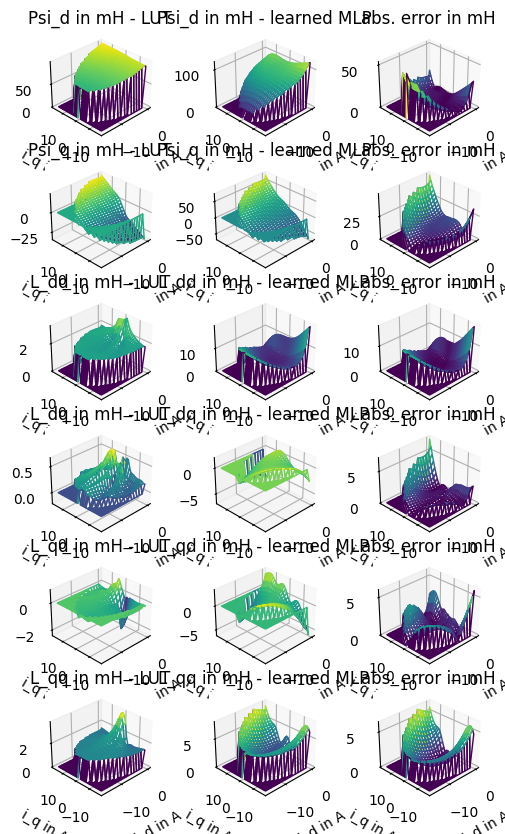

 84%|████████▍ | 419997/500000 [1:21:02<15:00, 88.87it/s]  

0.03159510024772498


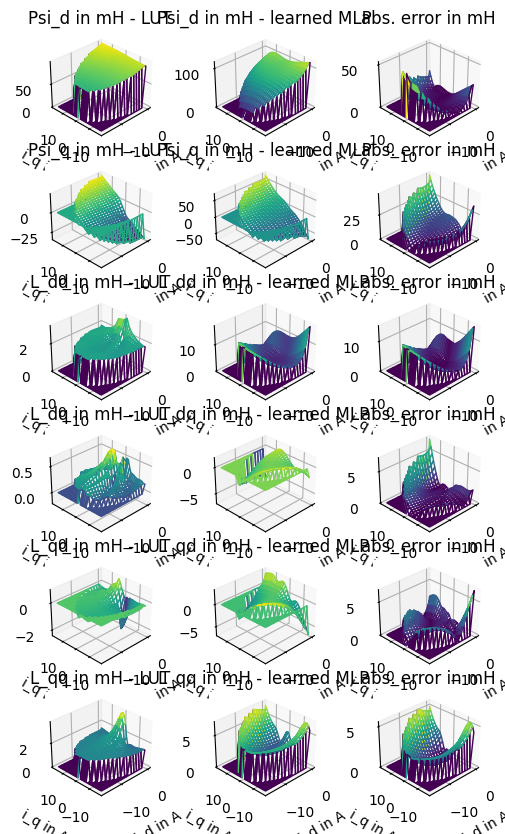

 86%|████████▌ | 429992/500000 [1:22:59<13:12, 88.38it/s]  

0.03161575286219169


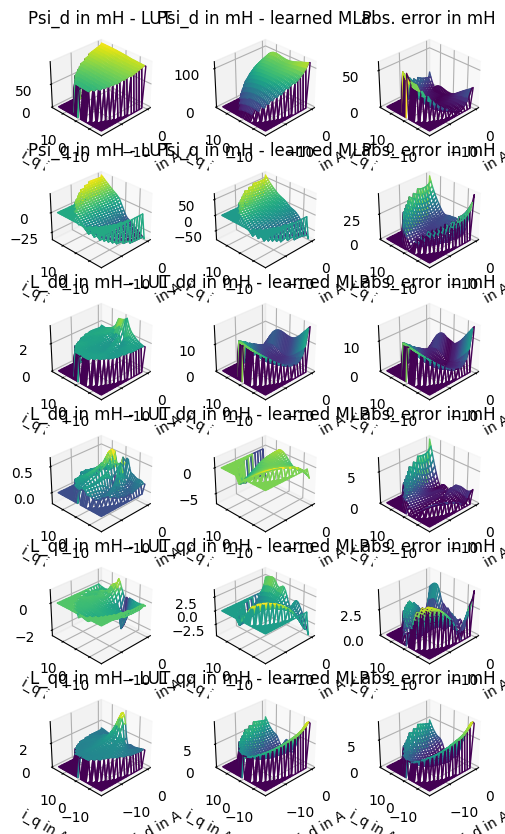

 88%|████████▊ | 439995/500000 [1:24:54<11:16, 88.72it/s]  

0.03172460234425577


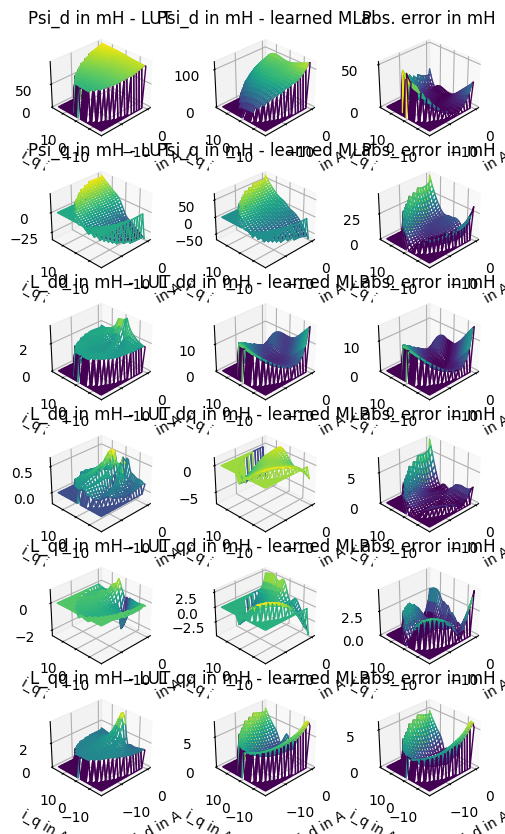

 90%|████████▉ | 449992/500000 [1:26:50<09:23, 88.74it/s]  

0.0315798113634656


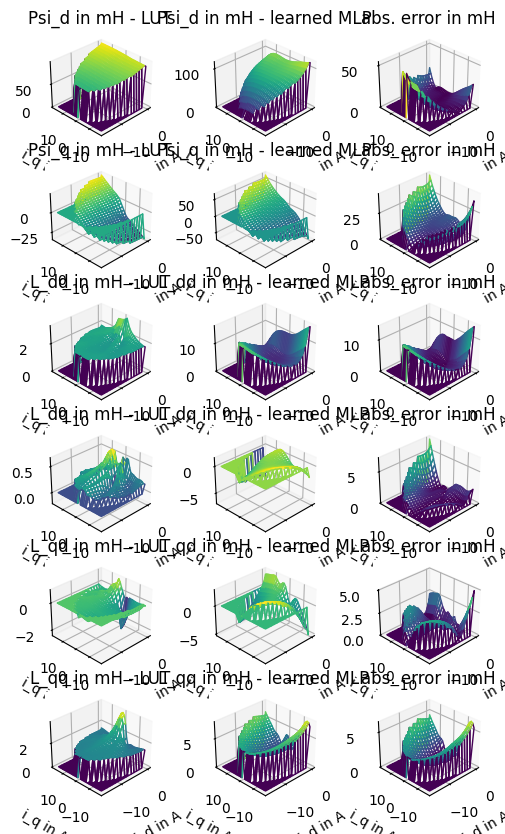

 92%|█████████▏| 459997/500000 [1:28:47<07:30, 88.73it/s]  

0.031686795177516935


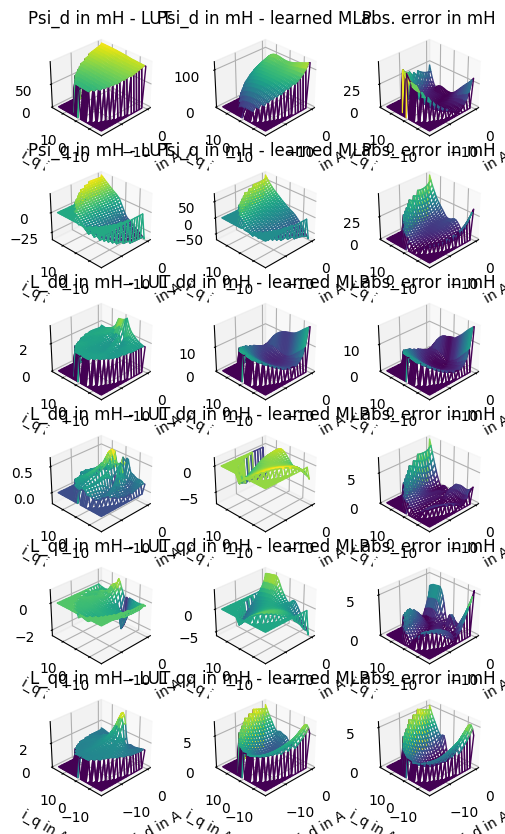

 94%|█████████▍| 469994/500000 [1:30:42<05:38, 88.75it/s]  

0.03154043558122805


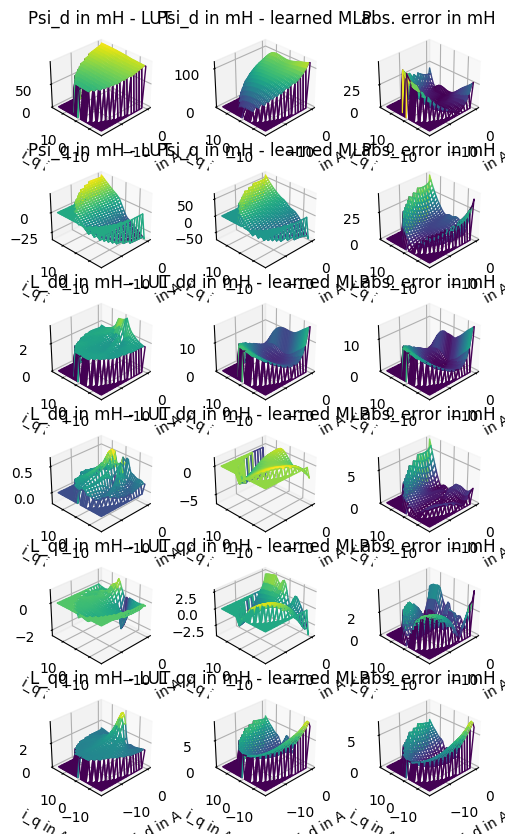

 96%|█████████▌| 479998/500000 [1:32:38<03:45, 88.58it/s]

0.03156210170547013


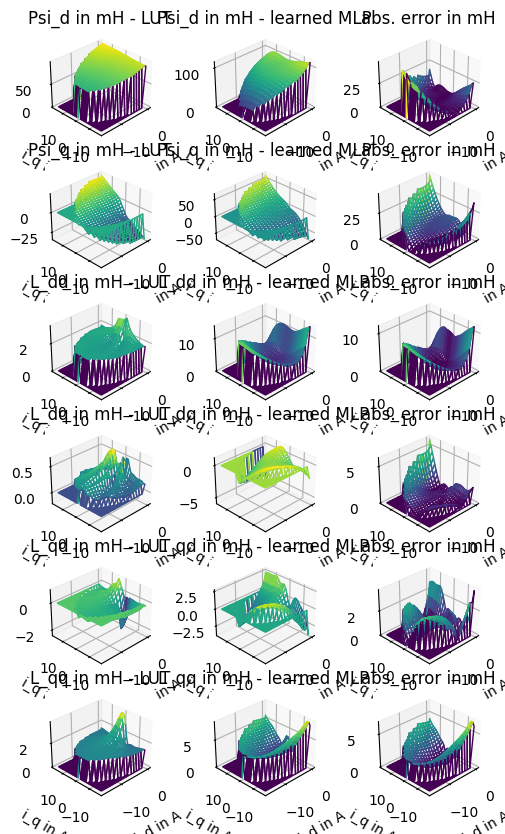

 98%|█████████▊| 489995/500000 [1:34:35<01:52, 88.73it/s]

0.031598817822603674


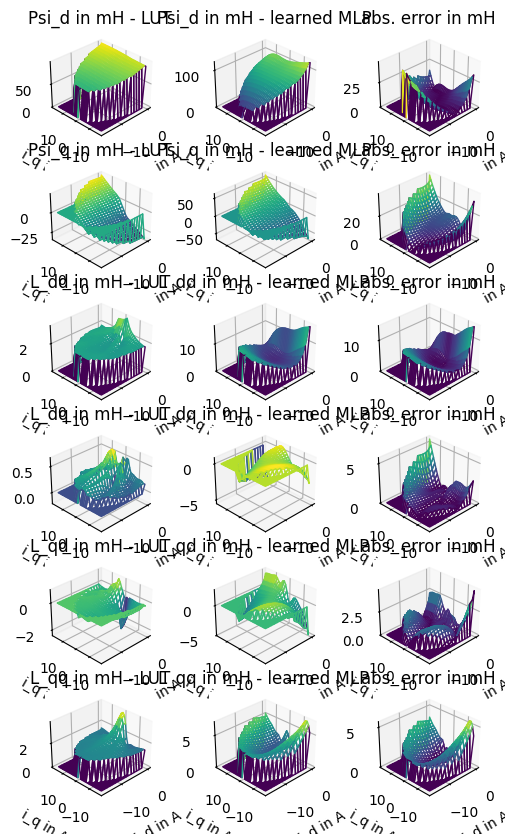

100%|██████████| 500000/500000 [1:36:30<00:00, 86.34it/s]


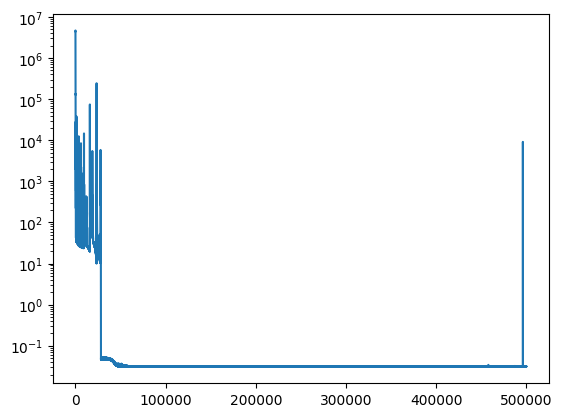

In [24]:
fin_node_20,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

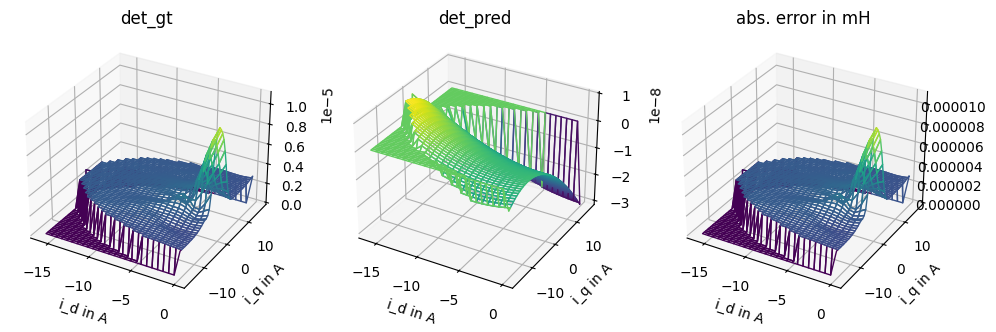

In [25]:
jax_key = jax.random.PRNGKey(21) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

290020.5261722031


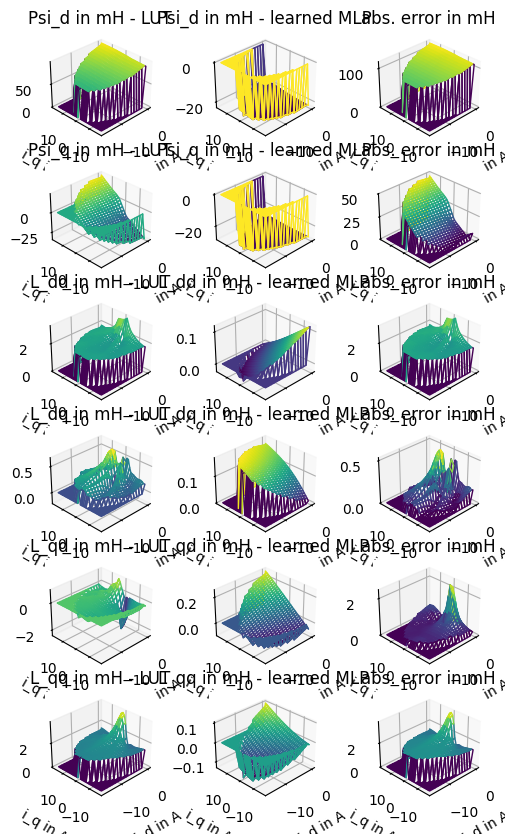

  2%|▏         | 9999/500000 [01:54<1:32:16, 88.50it/s]

0.15312950897728353


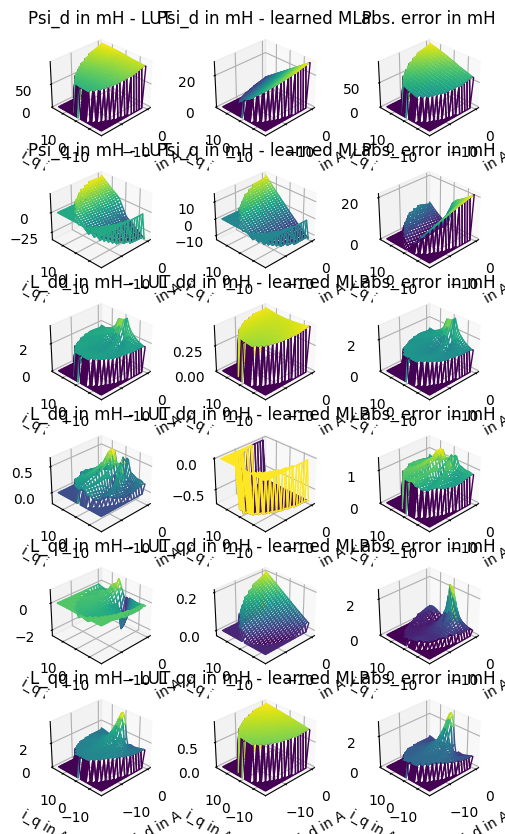

  4%|▍         | 20000/500000 [03:51<1:30:48, 88.10it/s] 

0.01701432090628122


  4%|▍         | 20000/500000 [03:54<1:33:50, 85.25it/s]


KeyboardInterrupt: 

In [26]:
fin_node_21,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

In [ ]:
jax_key = jax.random.PRNGKey(22) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

In [ ]:
fin_node_22,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

In [29]:
motor_env = PMSM(
    saturated=True,
    LUT_motor_name="BRUSA",
    batch_size=1,
    control_state=[], 
    static_params = {
            "p": 3,
            "r_s": 15e-3,
            "l_d": 0.37e-3,
            "l_q": 1.2e-3,
            "psi_p": 65.6e-3,
            "deadtime": 0,
    })

In [30]:
@eqx.filter_jit
def reset(node,rng):
    obs, _ = motor_env.reset(motor_env.env_properties, rng)  #
    obs = obs.at[2].set((3*1500 / 60 * 2 * jnp.pi) / (2 * jnp.pi * 3 * 11000 / 60))
    return obs

In [31]:
@eqx.filter_jit
def node_dat_gen_sin(node,reset_env, rng, traj_len):
    rng, subkey = jax.random.split(rng)
    ref_obs = reset_env(node,subkey) 
    rng, subkey = jax.random.split(rng)
    init_obs = reset_env(node,subkey)  
    return init_obs, ref_obs, rng

In [32]:
@eqx.filter_jit
def featurize(obs,ref_obs, featurize_state=jnp.array([0,0])):
    feat_obs=jnp.concatenate([obs[0:2],ref_obs[0:2],ref_obs[0:2]-obs[0:2],featurize_state])#jnp.concatenate([obs[0:2],obs[6:8],ref_obs[0:2],ref_obs[0:2]-obs[0:2],featurize_state])
    #featurize_state=jnp.clip(featurize_state + ref_obs[0:2]-obs[0:2],min=-1,max=1) * (jnp.sign(0.01-jnp.sum((ref_obs[0:2]-obs[0:2])**2))*0.5+0.5)
    return feat_obs,featurize_state

In [33]:
@eqx.filter_jit
def mse_loss(feat_obs):
    loss=jnp.mean(jnp.sum((feat_obs[:,4:6])**2,axis=1))#be aware of idx if changing featurize
    return loss

In [34]:
@eqx.filter_jit
def penalty_loss(feat_obs):
    loss=jnp.array([0])
    return loss

In [35]:
jax_key = jax.random.PRNGKey(2)
policy=MLP([8,64,64,64,2],key=jax_key,output_activation=jnp.tanh)
optimizer = optax.adam(5e-4)
opt_state = optimizer.init(policy)

In [36]:
data_batch_size=100
trainer=DPCTrainer(
    batch_size=data_batch_size,
    train_steps=2000,
    horizon_length=5,
    reset_env=reset,
    data_gen_sin=node_dat_gen_sin,
    featurize=featurize,
    policy_optimizer=optimizer,
    ref_loss=mse_loss,
    constr_penalty=penalty_loss,
    ref_loss_weight=1)
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(data_batch_size,)))
#key=jax.vmap(jax.random.PRNGKey)(jnp.linspace(0,1000,1001).astype(int))

In [37]:
import matplotlib.pyplot as plt
from utils.evaluation import steps_eval

In [38]:
def featurize_node(obs):
    return jnp.concatenate([obs[0:2],obs[4:6]])

In [ ]:
fin_policy_L_node,fin_opt_state,fin_keys,losses=trainer.fit_on_node_non_jit(policy, fin_node_12, motor_env.tau, featurize_node, keys, opt_state)
plt.plot(losses)
plt.yscale('log')

In [ ]:
obs,obs2,acts=steps_eval(motor_env,reset,fin_policy_L_node,featurize,jax.random.PRNGKey(4),2000)

In [35]:
data_batch_size=100
trainer2=DPCTrainer(
    batch_size=data_batch_size,
    train_steps=2000,
    horizon_length=20,
    reset_env=reset,
    data_gen_sin=node_dat_gen_sin,
    featurize=featurize,
    policy_optimizer=optimizer,
    ref_loss=mse_loss,
    constr_penalty=penalty_loss,
    ref_loss_weight=1)
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(data_batch_size,)))

In [ ]:
fin_policy_L_node_20,fin_opt_state,fin_keys,losses=trainer2.fit_on_node_non_jit(fin_policy_L_node, fin_node_12, motor_env.tau, featurize_node, keys, opt_state)
plt.plot(losses)
plt.yscale('log')

In [ ]:
obs,obs2,acts=steps_eval(motor_env,reset,fin_policy_L_node_20,featurize,jax.random.PRNGKey(4),2000)